## shNfkb1-all lanes
5/10/2023 - Data generated from shNfkb1 single hairpin experiments; Library included in alignment; data submitted by Jason/Carleigh/Hannah on 2/2/2023
Run on 2 lanes but partially clogged on lane 1 so '3' lanes (lane1, lane1_rerun, lane2)
Analyze global run on cellranger v6 data and create h5_ad files for further analysis

In [1]:
import numpy as np
import pandas as pd
import scanpy as sc
import pickle

import math
import matplotlib

from solo import hashsolo
import anndata

In [2]:
sc.settings.verbosity = 3             # verbosity: errors (0), warnings (1), info (2), hints (3)
sc.logging.print_header()
sc.settings.set_figure_params(dpi=80, facecolor='white')
np.random.seed(1573)   #fix so we can reproduce later

scanpy==1.9.1 anndata==0.8.0 umap==0.5.3 numpy==1.22.4 scipy==1.9.0 pandas==1.4.3 scikit-learn==1.1.2 statsmodels==0.13.2 python-igraph==0.9.11 pynndescent==0.5.7


In [3]:
results_file = 'write/allmice.h5ad'  # the file that will store the analysis results

In [5]:
library = ["1659-Fosl2.226","1660-Fosl2.752","1661-Fhl2.467","1662-Fhl2.179","1663-Myc.989","1664-Myc.1389","1665-Yap1.735","1666-Yap1.2847","1667-Atf4.1383","1668-Atf4.536","1669-Maff.85","1670-Maff.587","1671-Nfkb2.152","1672-Nfkb2.534","1673-Relb.286","1674-Relb.1795","1675-Onecut2.1799","1676-Onecut2.2361","1810-Slc4a11.541","1934-Slc4a11.1966","1811-Itga2.672","1812-Itga2.204","1998-Cldn4-1013","1999-Cldn4-951","2113-Lif.440","2114-Lif.1890","2115-Fosl1.1401","2116-Fosl1.699","2117-Nfkb1.2331","2118-Nfkb1.3737","2190-Jun_2481","2191-Jun_3136","2193-JunB_406","2194-JunD_78","2195-JunD_859","JCP618-Rela_1202","JCP621-Rela_1182","JCP623-Rel_1868","JCP625-Rel_342","JCP628-Ikbkg_2526","JCP629-Ikbkg_2984"]

Read in the count matrix into an [`AnnData`](https://anndata.readthedocs.io/en/latest/anndata.AnnData.html) object, which holds many slots for annotations and different representations of the data. It also comes with its own HDF5 file format: `.h5ad`.

In [4]:
adata_A = sc.read_h5ad('write/allmice-tumornoSCT_lane1.h5ad')
adata_B = sc.read_h5ad('write/allmice-tumornoSCT_lane1_rerun.h5ad')
adata_C = sc.read_h5ad('write/allmice-tumornoSCT_lane2.h5ad')

In [6]:
adatas = [adata_A, adata_B, adata_C]

In [7]:
samples = adata_A.obs.Classification.cat.categories

In [8]:
print(samples)

Index(['AT1129_B0304_2117', 'AT1606_B0305_Renilla', 'AT1607_B0307_Renilla',
       'AT1831_B0306_2117', 'AT1939_B0301_Renilla', 'AT1940_B0302_Renilla',
       'AT1944_B0303_2117', 'AV1189_B0310_2118', 'BA1525_B0308_2118',
       'BA1526_B0309_2118'],
      dtype='object')


Basic filtering:

Let's assemble some information about mitochondrial genes, which are important for quality control.

Citing from "Simple Single Cell" workflows [(Lun, McCarthy & Marioni, 2017)](https://master.bioconductor.org/packages/release/workflows/html/simpleSingleCell.html#examining-gene-level-metrics):

> High proportions are indicative of poor-quality cells (Islam et al. 2014; Ilicic et al. 2016), possibly because of loss of cytoplasmic RNA from perforated cells. The reasoning is that mitochondria are larger than individual transcript molecules and less likely to escape through tears in the cell membrane.

With `pp.calculate_qc_metrics`, we can compute many metrics very efficiently.

In [9]:
for x in range(0, len(adatas)):
    adatas[x].var['mt'] = adatas[x].var_names.str.startswith('mt-') # annotate the group of mitochondrial genes as 'MT'
    sc.pp.calculate_qc_metrics(adatas[x], qc_vars=['mt'], percent_top=None, log1p=False, inplace=True)

A violin plot of some of the computed quality measures:

* the number of genes expressed in the count matrix
* the total counts per cell
* the percentage of counts in mitochondrial genes

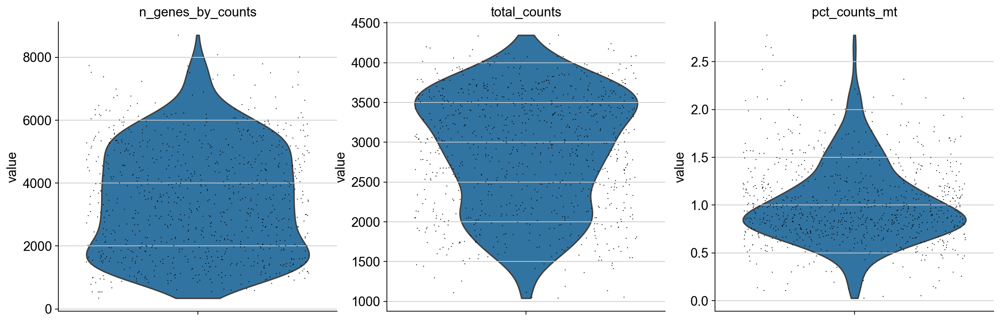

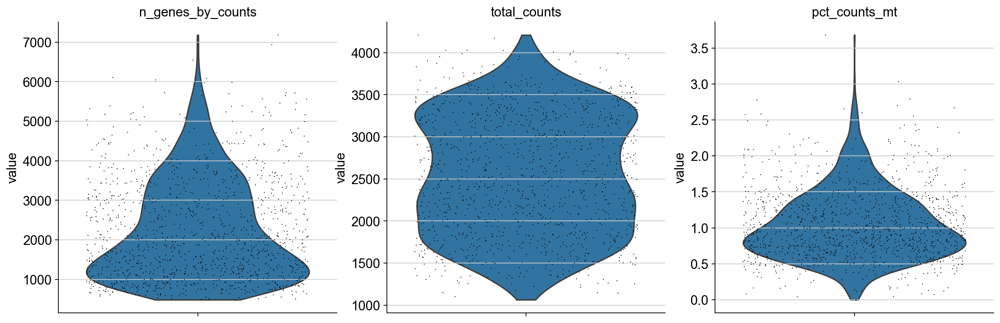

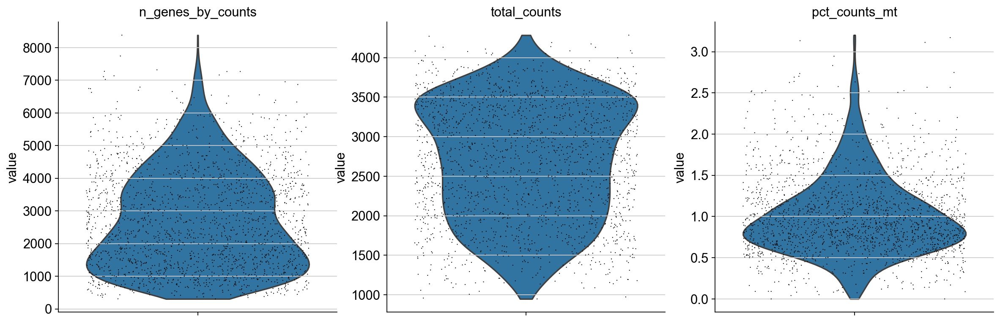

In [10]:
for x in range(0, len(adatas)):
    sc.pl.violin(adatas[x], ['n_genes_by_counts', 'total_counts', 'pct_counts_mt'],
                 jitter=0.4, multi_panel=True, rotation=90) #groupby='Classification',

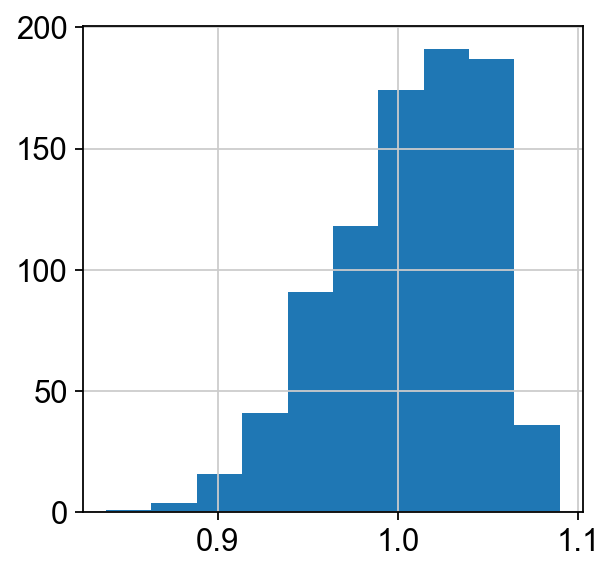

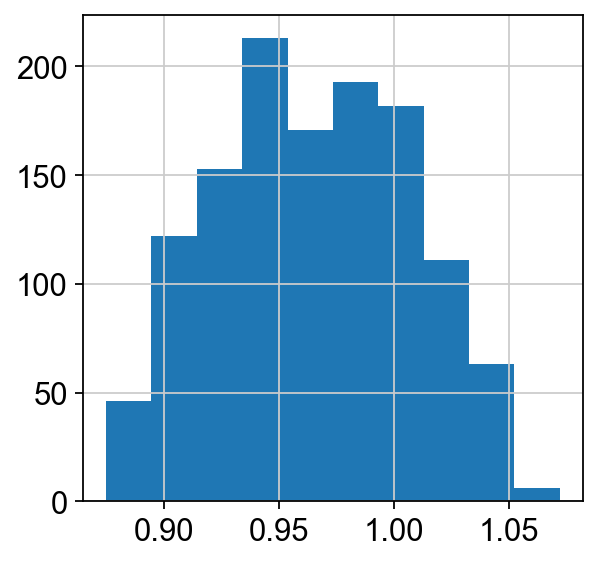

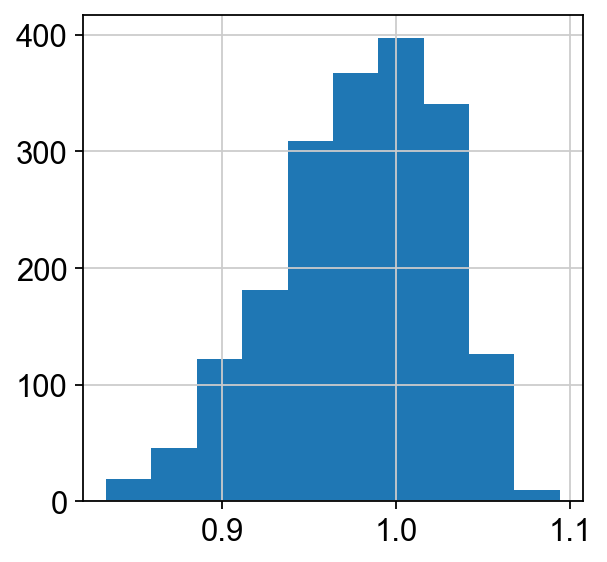

In [11]:
for x in range(0, len(adatas)):
    adatas[x].obs["log10GenesPerUMI"] = adatas[x].obs['n_genes_by_counts'].apply(math.log10) / adatas[x].obs['total_counts'].apply(math.log10)
    matplotlib.pyplot.hist(adatas[x].obs["log10GenesPerUMI"])
    matplotlib.pyplot.show()

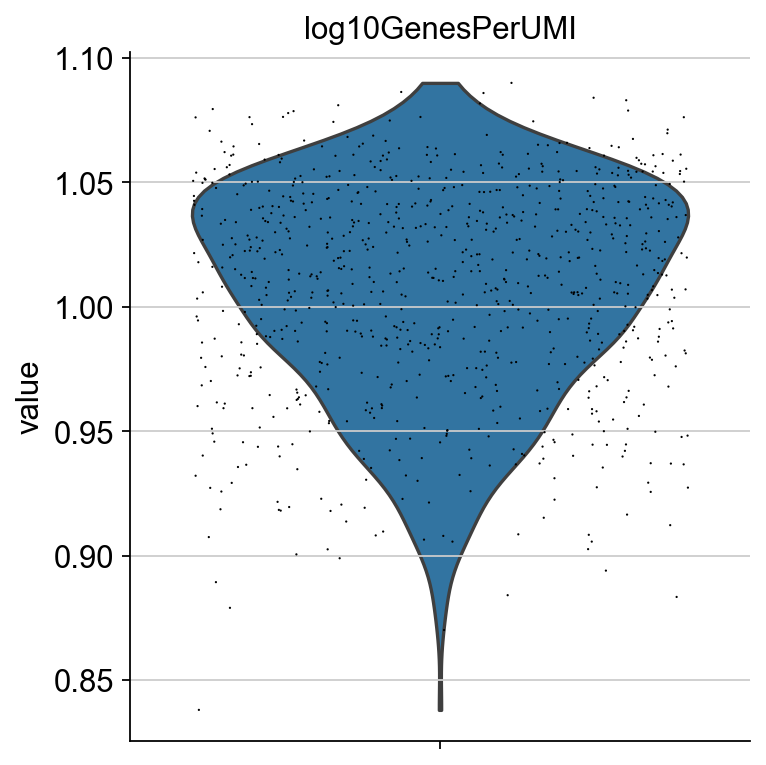

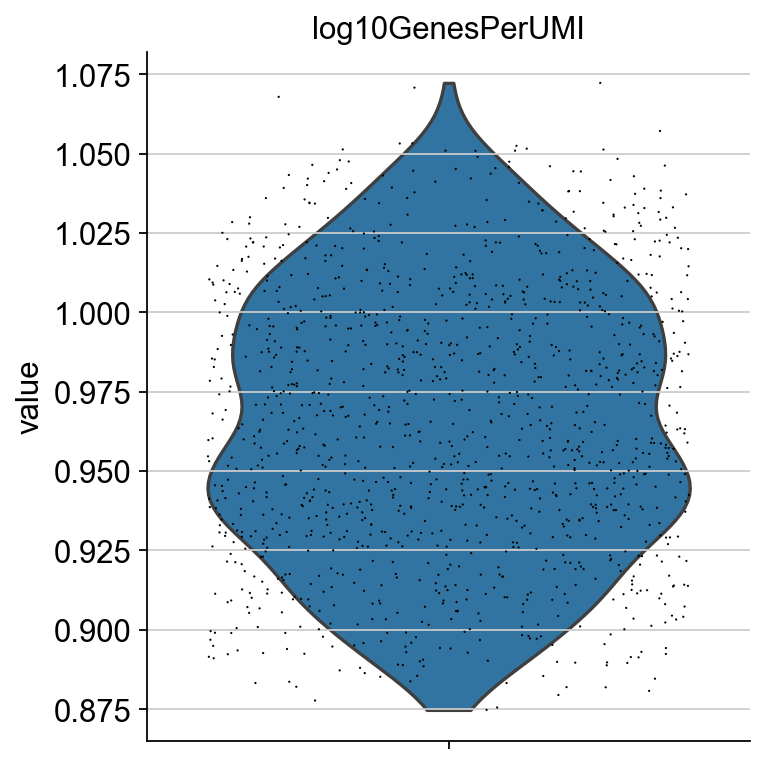

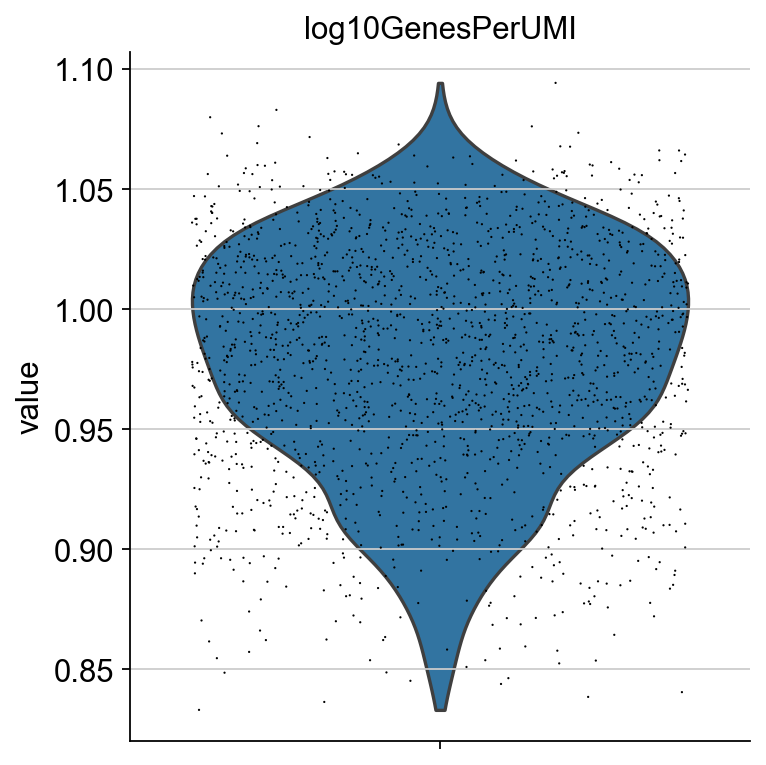

In [12]:
for x in range(0, len(adatas)):
    sc.pl.violin(adatas[x], ['log10GenesPerUMI'],
                 jitter=0.4, multi_panel=True, rotation=90)#groupby='Classification',


## Concatenate adatas or ingest or integrate

In [13]:
adata = adatas[0].concatenate(adatas[1:], join='inner', batch_categories=['lane1', 'lane1_rerun', 'lane2'])

/Users/chanj2/opt/miniconda3/envs/scanalysis202208/lib/python3.10/site-packages/anndata/_core/anndata.py:1785: FutureWarning: X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  [AnnData(sparse.csr_matrix(a.shape), obs=a.obs) for a in all_adatas],


In [14]:
adata

AnnData object with n_obs × n_vars = 4037 × 21109
    obs: 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'log10GenesPerUMI', 'Classification', 'n_counts', 'batch'
    var: 'gene_ids', 'feature_types', 'genome', 'mt', 'n_cells-lane1', 'n_cells_by_counts-lane1', 'mean_counts-lane1', 'pct_dropout_by_counts-lane1', 'total_counts-lane1', 'highly_variable-lane1', 'means-lane1', 'dispersions-lane1', 'dispersions_norm-lane1', 'n_cells-lane1_rerun', 'n_cells_by_counts-lane1_rerun', 'mean_counts-lane1_rerun', 'pct_dropout_by_counts-lane1_rerun', 'total_counts-lane1_rerun', 'highly_variable-lane1_rerun', 'means-lane1_rerun', 'dispersions-lane1_rerun', 'dispersions_norm-lane1_rerun', 'n_cells-lane2', 'n_cells_by_counts-lane2', 'mean_counts-lane2', 'pct_dropout_by_counts-lane2', 'total_counts-lane2', 'highly_variable-lane2', 'means-lane2', 'dispersions-lane2', 'dispersions_norm-lane2'

In [15]:
hadata = adata.copy()

In [16]:
sc.pp.normalize_total(hadata, target_sum=1e4)

normalizing counts per cell
    finished (0:00:00)


Logarithmize the data:

In [17]:
sc.pp.log1p(hadata)

In [20]:
sc.pp.highly_variable_genes(hadata, batch_key="batch")

extracting highly variable genes


/Users/chanj2/opt/miniconda3/envs/scanalysis202208/lib/python3.10/site-packages/scanpy/preprocessing/_highly_variable_genes.py:478: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  hvg = hvg.append(missing_hvg, ignore_index=True)
/Users/chanj2/opt/miniconda3/envs/scanalysis202208/lib/python3.10/site-packages/scanpy/preprocessing/_highly_variable_genes.py:478: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  hvg = hvg.append(missing_hvg, ignore_index=True)


    finished (0:00:01)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)


/Users/chanj2/opt/miniconda3/envs/scanalysis202208/lib/python3.10/site-packages/scanpy/preprocessing/_highly_variable_genes.py:478: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  hvg = hvg.append(missing_hvg, ignore_index=True)


In [21]:
hadata = hadata[:, hadata.var.highly_variable]

In [22]:
sc.pp.scale(hadata, max_value=10)

... as `zero_center=True`, sparse input is densified and may lead to large memory consumption


/Users/chanj2/opt/miniconda3/envs/scanalysis202208/lib/python3.10/site-packages/scanpy/preprocessing/_simple.py:843: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


## Principal component analysis

Reduce the dimensionality of the data by running principal component analysis (PCA), which reveals the main axes of variation and denoises the data.

In [23]:
sc.tl.pca(hadata, svd_solver='arpack', n_comps=150)

computing PCA
    on highly variable genes
    with n_comps=150
    finished (0:00:01)


We can make a scatter plot in the PCA coordinates, but we will not use that later on.

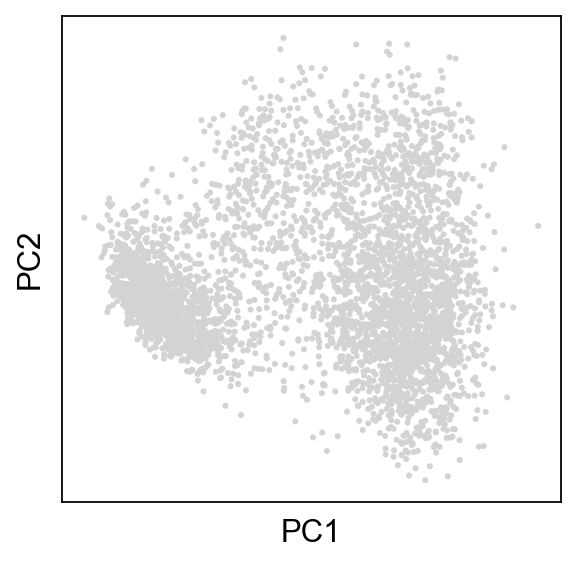

In [24]:
sc.pl.pca(hadata)

Let us inspect the contribution of single PCs to the total variance in the data. This gives us information about how many PCs we should consider in order to compute the neighborhood relations of cells, e.g. used in the clustering function  `sc.tl.louvain()` or tSNE `sc.tl.tsne()`. In our experience, often a rough estimate of the number of PCs does fine.

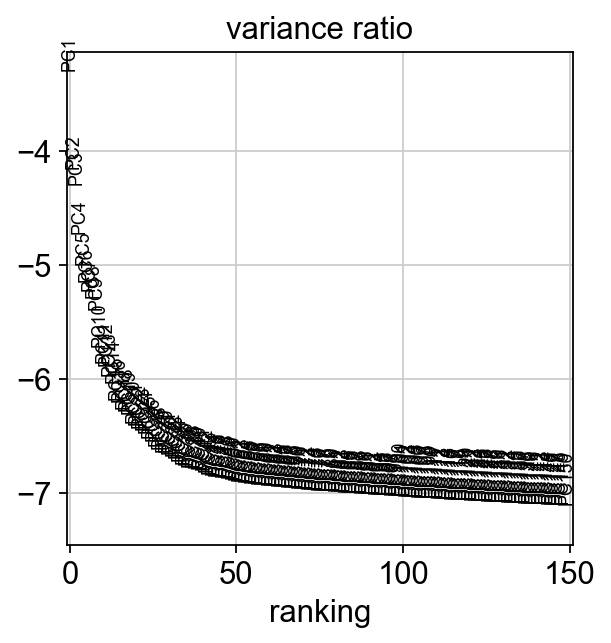

In [25]:
sc.pl.pca_variance_ratio(hadata, log=True, n_pcs=150)

## Computing the neighborhood graph

Let us compute the neighborhood graph of cells using the PCA representation of the data matrix. You might simply use default values here. For the sake of reproducing Seurat's results, let's take the following values.

In [26]:
sc.pp.neighbors(hadata, n_neighbors=15, n_pcs=50)

computing neighbors
    using 'X_pca' with n_pcs = 50
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:02)


## Embedding the neighborhood graph

We suggest embedding the graph in two dimensions using UMAP ([McInnes et al., 2018](https://arxiv.org/abs/1802.03426)), see below. It is potentially more faithful to the global connectivity of the manifold than tSNE, i.e., it better preserves trajectories. In some ocassions, you might still observe disconnected clusters and similar connectivity violations. They can usually be remedied by running:

```
tl.paga(adata)
pl.paga(adata, plot=False)  # remove `plot=False` if you want to see the coarse-grained graph
tl.umap(adata, init_pos='paga')
```

In [27]:
sc.tl.umap(hadata)

computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:05)


In [28]:
samples

Index(['AT1129_B0304_2117', 'AT1606_B0305_Renilla', 'AT1607_B0307_Renilla',
       'AT1831_B0306_2117', 'AT1939_B0301_Renilla', 'AT1940_B0302_Renilla',
       'AT1944_B0303_2117', 'AV1189_B0310_2118', 'BA1525_B0308_2118',
       'BA1526_B0309_2118'],
      dtype='object')

/Users/chanj2/opt/miniconda3/envs/scanalysis202208/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1171: FutureWarning: Categorical.replace is deprecated and will be removed in a future version. Use Series.replace directly instead.
  values = values.replace(values.categories.difference(groups), np.nan)


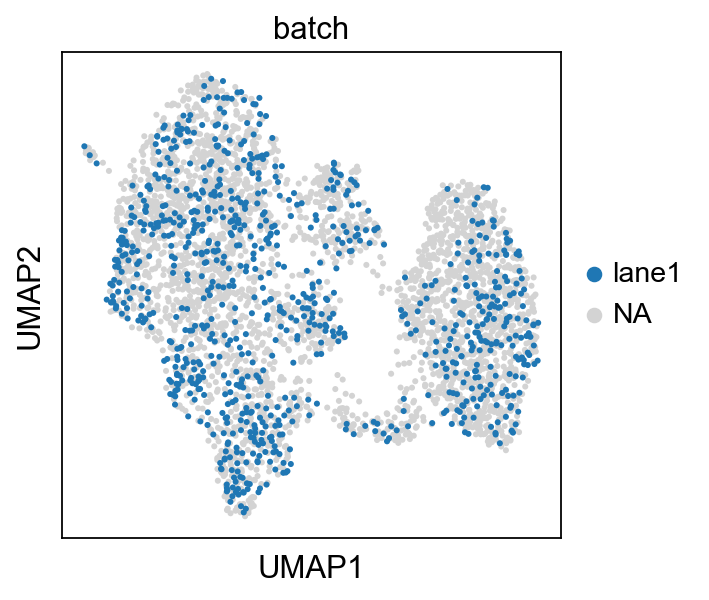

/Users/chanj2/opt/miniconda3/envs/scanalysis202208/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1171: FutureWarning: Categorical.replace is deprecated and will be removed in a future version. Use Series.replace directly instead.
  values = values.replace(values.categories.difference(groups), np.nan)


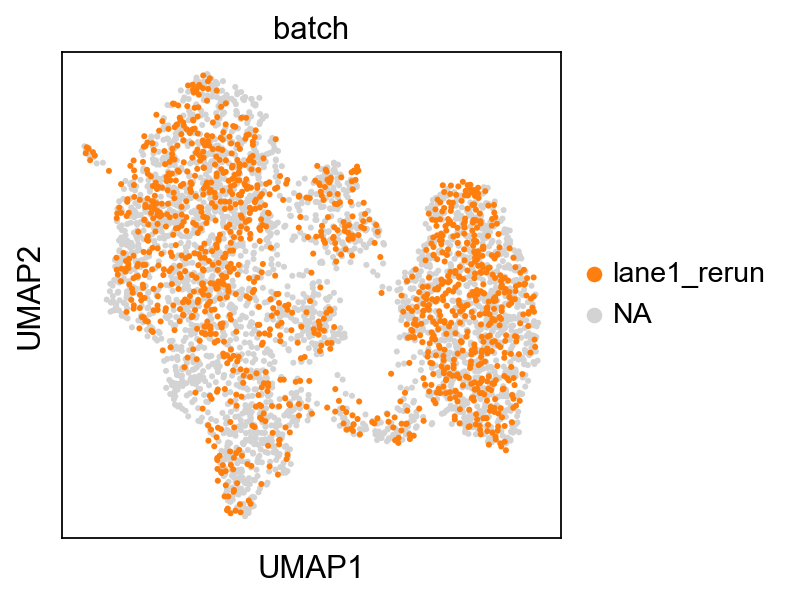

/Users/chanj2/opt/miniconda3/envs/scanalysis202208/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1171: FutureWarning: Categorical.replace is deprecated and will be removed in a future version. Use Series.replace directly instead.
  values = values.replace(values.categories.difference(groups), np.nan)


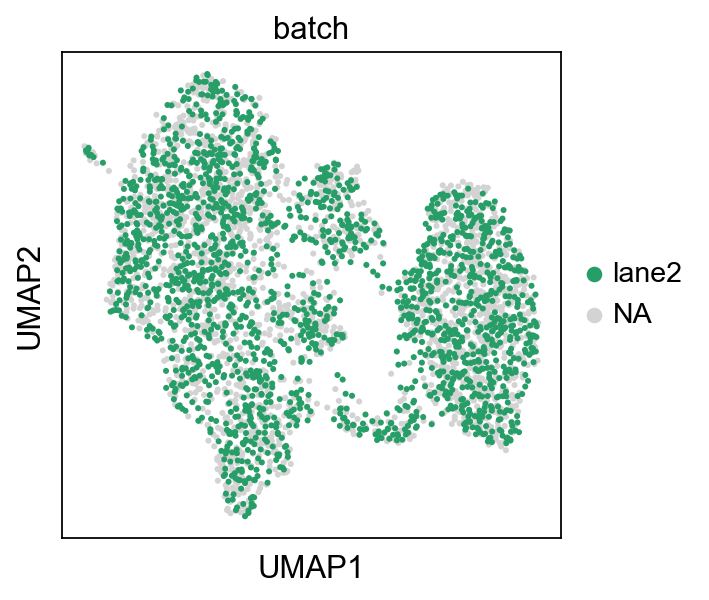

In [29]:
for x in hadata.obs.batch.cat.categories:
    sc.pl.umap(hadata, color='batch', groups=[x])

/Users/chanj2/opt/miniconda3/envs/scanalysis202208/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1171: FutureWarning: Categorical.replace is deprecated and will be removed in a future version. Use Series.replace directly instead.
  values = values.replace(values.categories.difference(groups), np.nan)


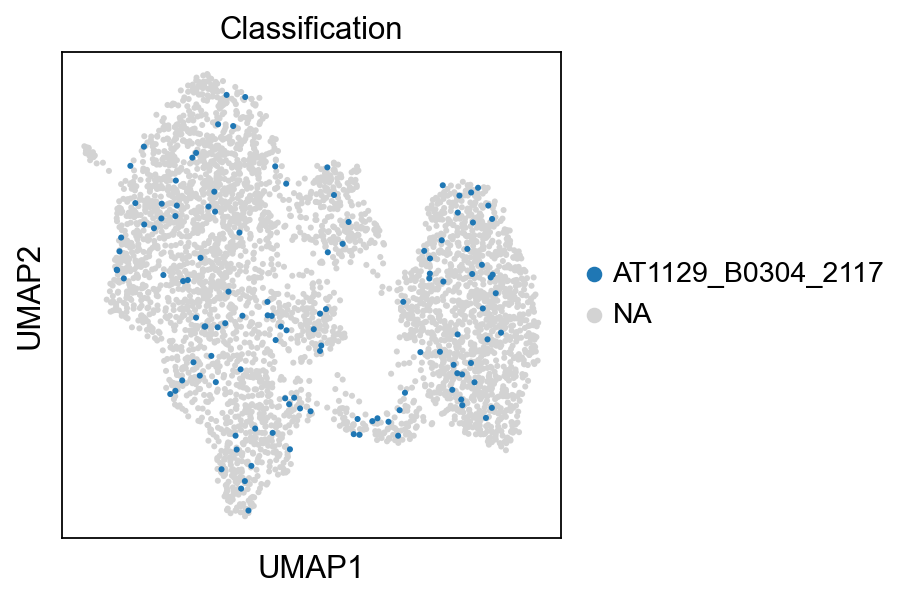

/Users/chanj2/opt/miniconda3/envs/scanalysis202208/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1171: FutureWarning: Categorical.replace is deprecated and will be removed in a future version. Use Series.replace directly instead.
  values = values.replace(values.categories.difference(groups), np.nan)


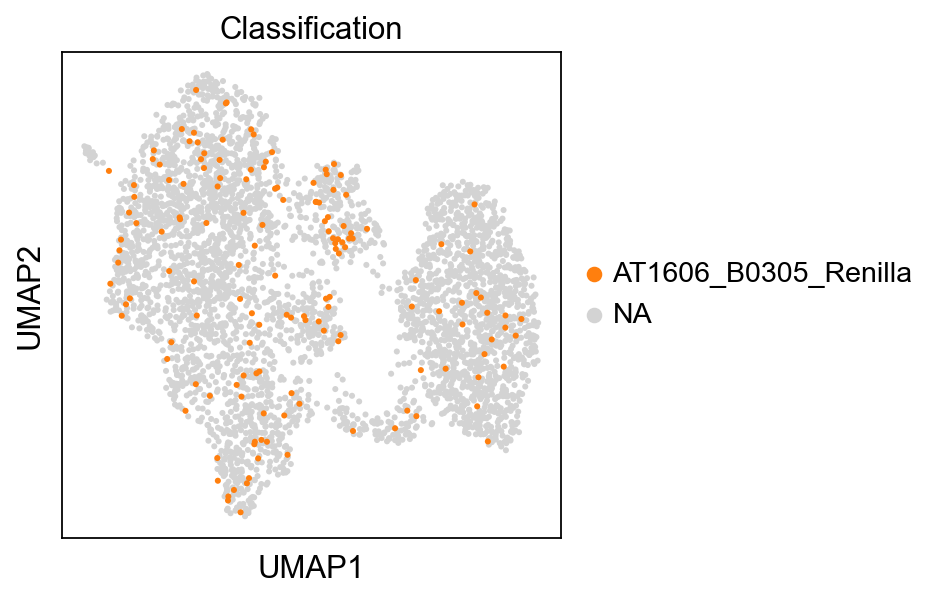

/Users/chanj2/opt/miniconda3/envs/scanalysis202208/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1171: FutureWarning: Categorical.replace is deprecated and will be removed in a future version. Use Series.replace directly instead.
  values = values.replace(values.categories.difference(groups), np.nan)


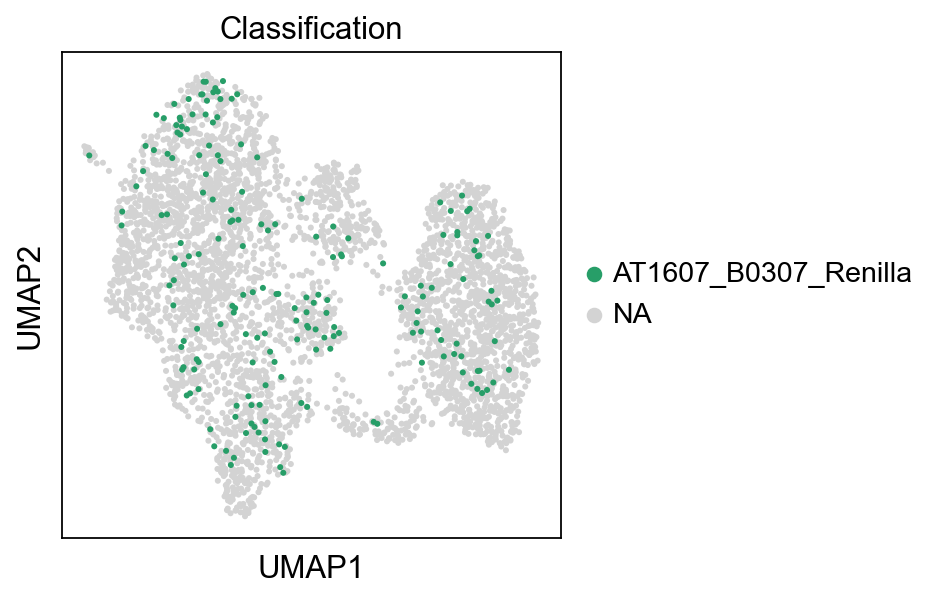

/Users/chanj2/opt/miniconda3/envs/scanalysis202208/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1171: FutureWarning: Categorical.replace is deprecated and will be removed in a future version. Use Series.replace directly instead.
  values = values.replace(values.categories.difference(groups), np.nan)


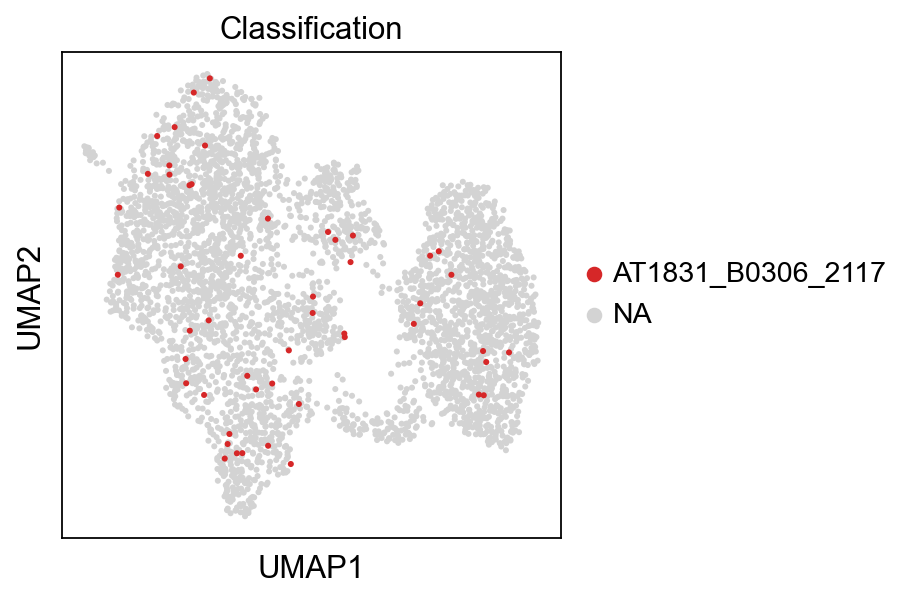

/Users/chanj2/opt/miniconda3/envs/scanalysis202208/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1171: FutureWarning: Categorical.replace is deprecated and will be removed in a future version. Use Series.replace directly instead.
  values = values.replace(values.categories.difference(groups), np.nan)


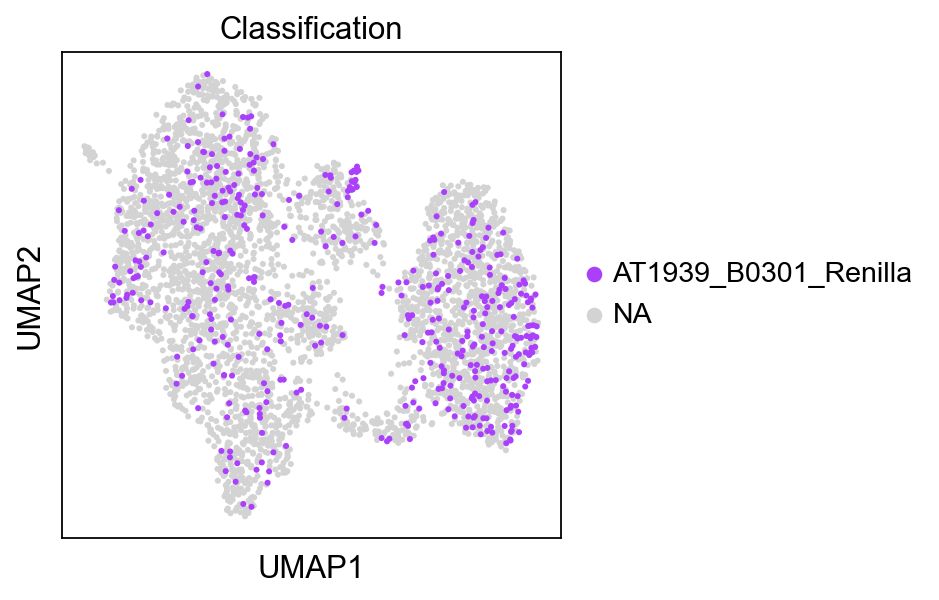

/Users/chanj2/opt/miniconda3/envs/scanalysis202208/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1171: FutureWarning: Categorical.replace is deprecated and will be removed in a future version. Use Series.replace directly instead.
  values = values.replace(values.categories.difference(groups), np.nan)


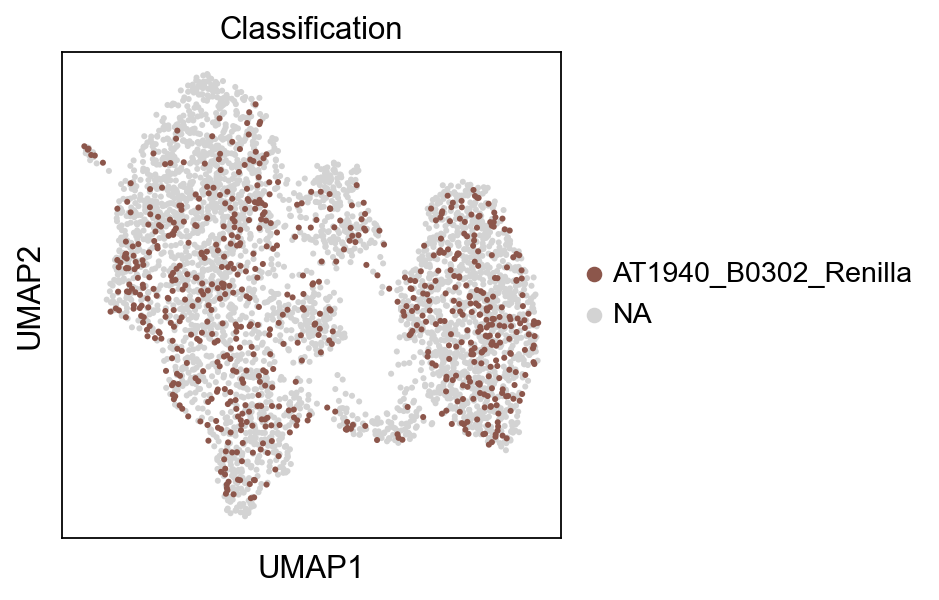

/Users/chanj2/opt/miniconda3/envs/scanalysis202208/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1171: FutureWarning: Categorical.replace is deprecated and will be removed in a future version. Use Series.replace directly instead.
  values = values.replace(values.categories.difference(groups), np.nan)


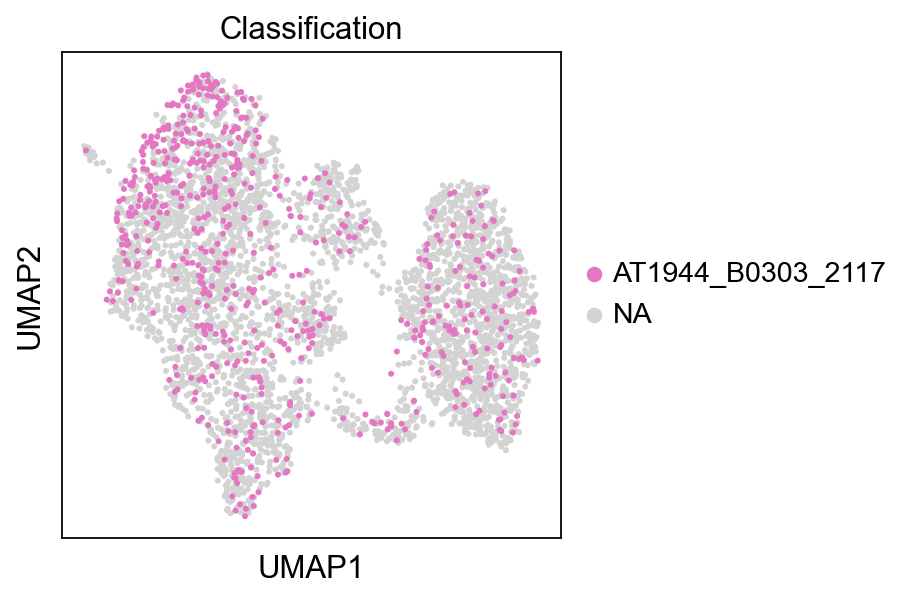

/Users/chanj2/opt/miniconda3/envs/scanalysis202208/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1171: FutureWarning: Categorical.replace is deprecated and will be removed in a future version. Use Series.replace directly instead.
  values = values.replace(values.categories.difference(groups), np.nan)


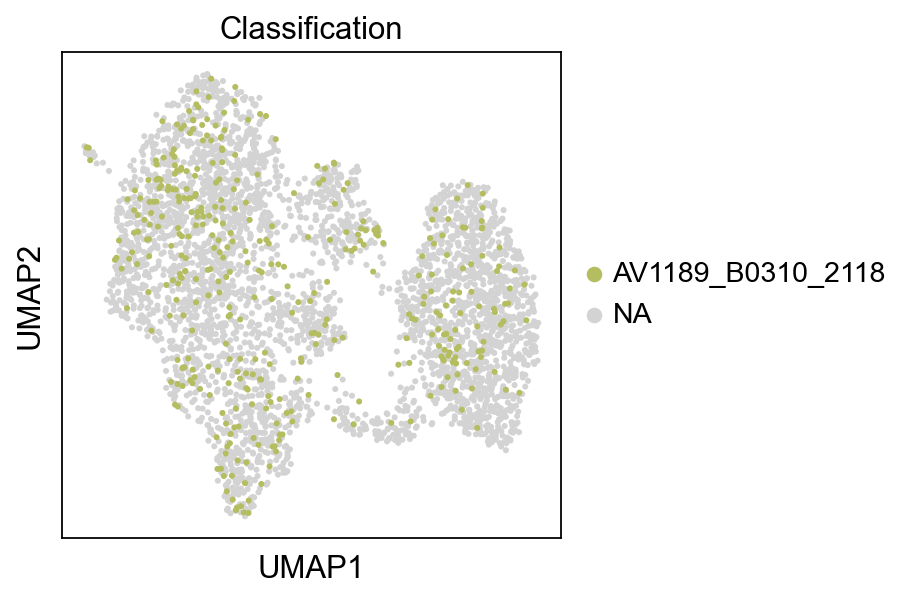

/Users/chanj2/opt/miniconda3/envs/scanalysis202208/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1171: FutureWarning: Categorical.replace is deprecated and will be removed in a future version. Use Series.replace directly instead.
  values = values.replace(values.categories.difference(groups), np.nan)


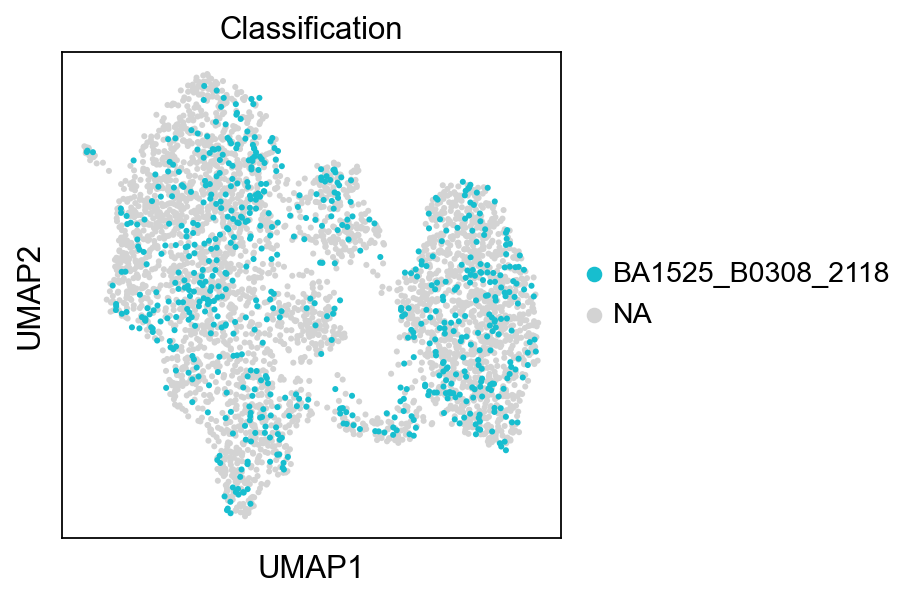

/Users/chanj2/opt/miniconda3/envs/scanalysis202208/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1171: FutureWarning: Categorical.replace is deprecated and will be removed in a future version. Use Series.replace directly instead.
  values = values.replace(values.categories.difference(groups), np.nan)


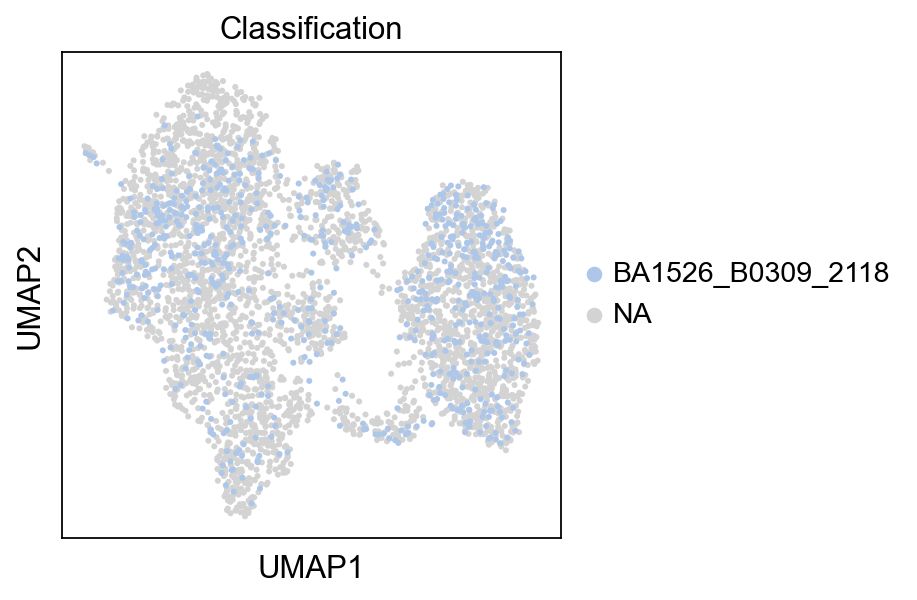

In [30]:
for x in hadata.obs.Classification.cat.categories:
        sc.pl.umap(hadata, color='Classification', groups=[x])

In [31]:
hadata.obs

,n_genes,n_genes_by_counts,total_counts,total_counts_mt,pct_counts_mt,log10GenesPerUMI,Classification,n_counts,batch
AAACGAAAGTGTACCT-1-lane1,2348,2347,3034.241699,6.337640,0.208871,0.967968,BA1525_B0308_2118,NaN,lane1
AAACGAAGTTTATGCG-1-lane1,2191,2190,2404.371582,41.800125,1.738505,0.988004,BA1526_B0309_2118,NaN,lane1
AAAGAACTCCAACCAA-1-lane1,5387,5384,3706.924316,28.098700,0.758006,1.045416,BA1525_B0308_2118,NaN,lane1
AAAGGATGTCGGTACC-1-lane1,6150,6145,3853.325439,31.356264,0.813745,1.056524,AT1940_B0302_Renilla,NaN,lane1
AAAGGGCCAGCTCATA-1-lane1,1489,1489,2013.201416,21.362364,1.061114,0.960352,AT1939_B0301_Renilla,NaN,lane1
...,...,...,...,...,...,...,...,...,...
TTTGTTGAGACCATAA-1-lane2,2375,2375,2162.908203,13.152652,0.608100,1.012181,AT1831_B0306_2117,NaN,lane2
TTTGTTGAGATTCGCT-1-lane2,2471,2471,2584.637939,5.465376,0.211456,0.994278,AT1940_B0302_Renilla,NaN,lane2
TTTGTTGGTACAAGTA-1-lane2,1647,1647,2256.146240,21.845036,0.968246,0.959243,AT1129_B0304_2117,NaN,lane2
TTTGTTGTCGAGAAGC-1-lane2,3544,3543,3519.573486,26.305349,0.747402,1.000812,BA1526_B0309_2118,NaN,lane2


In [32]:
adata

AnnData object with n_obs × n_vars = 4037 × 21109
    obs: 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'log10GenesPerUMI', 'Classification', 'n_counts', 'batch'
    var: 'gene_ids', 'feature_types', 'genome', 'mt', 'n_cells-lane1', 'n_cells_by_counts-lane1', 'mean_counts-lane1', 'pct_dropout_by_counts-lane1', 'total_counts-lane1', 'highly_variable-lane1', 'means-lane1', 'dispersions-lane1', 'dispersions_norm-lane1', 'n_cells-lane1_rerun', 'n_cells_by_counts-lane1_rerun', 'mean_counts-lane1_rerun', 'pct_dropout_by_counts-lane1_rerun', 'total_counts-lane1_rerun', 'highly_variable-lane1_rerun', 'means-lane1_rerun', 'dispersions-lane1_rerun', 'dispersions_norm-lane1_rerun', 'n_cells-lane2', 'n_cells_by_counts-lane2', 'mean_counts-lane2', 'pct_dropout_by_counts-lane2', 'total_counts-lane2', 'highly_variable-lane2', 'means-lane2', 'dispersions-lane2', 'dispersions_norm-lane2'

In [33]:
sc.pp.normalize_total(adata, target_sum=1e4)

normalizing counts per cell
    finished (0:00:00)


Logarithmize the data:

In [34]:
sc.pp.log1p(adata)

## set highly variable genes before moving all mean to 0

In [35]:
#sc.pp.highly_variable_genes(adata, batch_key="Classification", flavor='seurat_v3',n_top_genes=2000)
#sc.pp.highly_variable_genes(adata, batch_key="Classification")
sc.pp.highly_variable_genes(adata) #, batch_key='Classification')

extracting highly variable genes
    finished (0:00:00)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)


In [36]:
adata.var.highly_variable['mKate2'] = False
adata.var.highly_variable['GFP'] = False
for x in library:
    adata.var.highly_variable[x] = False

/var/folders/xc/wjwqs2j55dqgp2ghrn6nmlj1nlk7kz/T/ipykernel_86456/924550702.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  adata.var.highly_variable['mKate2'] = False
/var/folders/xc/wjwqs2j55dqgp2ghrn6nmlj1nlk7kz/T/ipykernel_86456/924550702.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  adata.var.highly_variable['GFP'] = False
/var/folders/xc/wjwqs2j55dqgp2ghrn6nmlj1nlk7kz/T/ipykernel_86456/924550702.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#return

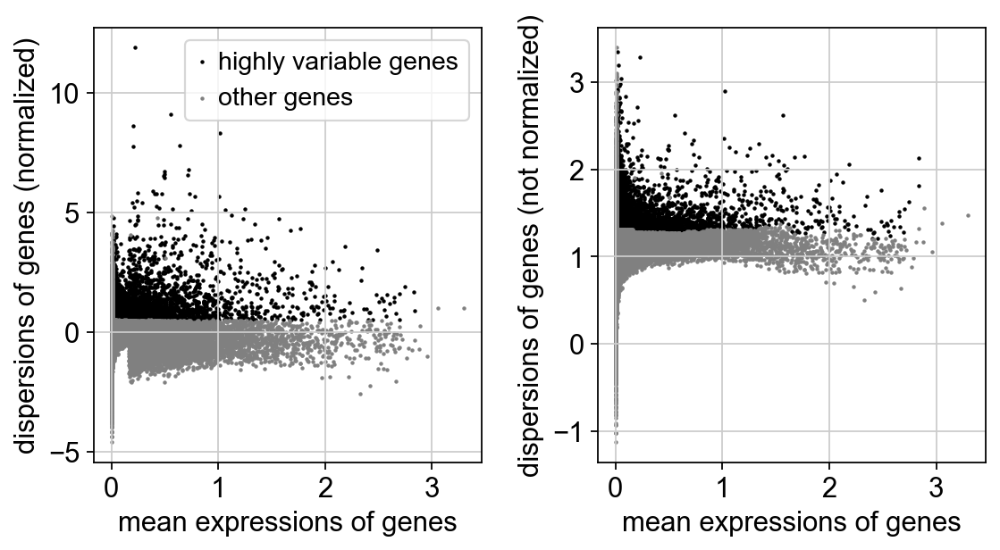

In [37]:
sc.pl.highly_variable_genes(adata)

In [38]:
adata.raw = adata

In [39]:
adata.write('write/allmice_ingested.h5ad', compression='gzip')

In [40]:
adata = sc.read('write/allmice_ingested.h5ad')

In [41]:
#fix a bug; 'base' is None but that doesn't seem to have transferred
adata.uns['log1p']['base'] = None

<div class="alert alert-info">

**Note**

You can get back an `AnnData` of the object in `.raw` by calling `.raw.to_adata()`.

</div>    

Actually do the filtering

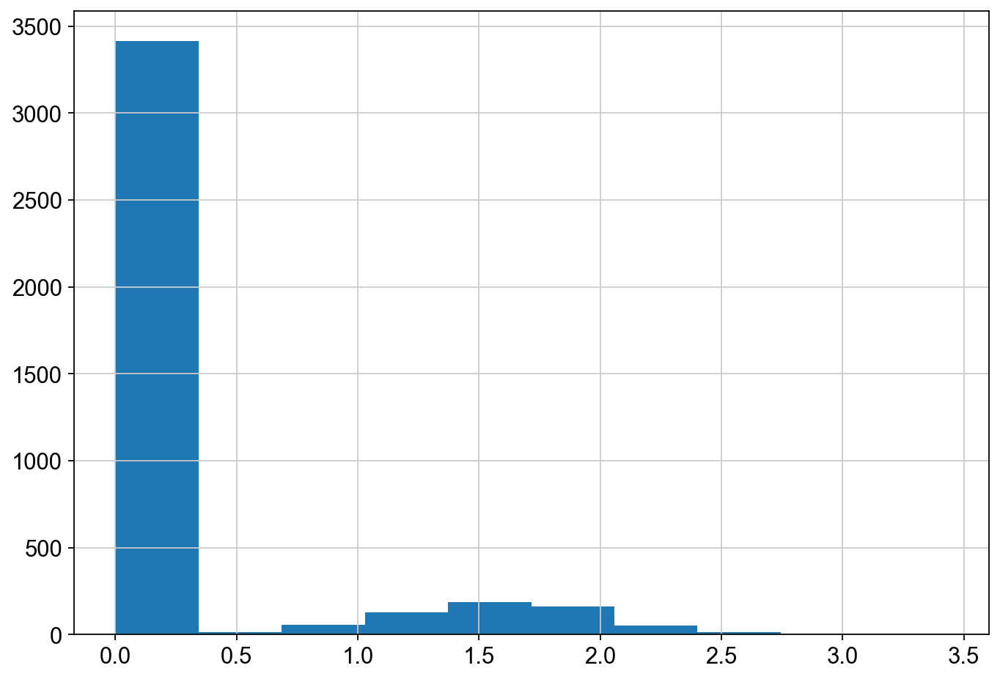

In [42]:
import matplotlib.pyplot as plt
fig, ax = plt.subplots(figsize =(10, 7))
ax.hist(adata[:,adata.var.index.isin(['GFP'])].X.toarray())
#ax.axvline(np.log10(int(hashDisc.loc["90%",hashName])+1), color='k', linestyle='dashed', linewidth=1)
# Show plot
plt.show()
#adata = adata[adata.X[:,adata.var.index.isin(['Ptprc'])] < 0.5,:]

In [43]:
GFPCells = adata[adata.X[:,adata.var.index.isin(['GFP'])] >= 0.5,:].obs.index

In [44]:
adata = adata[:, adata.var.highly_variable]

Regress out effects of total counts per cell and the percentage of mitochondrial genes expressed. Scale the data to unit variance.

In [45]:
sc.pp.regress_out(adata, ['total_counts', 'pct_counts_mt'])

regressing out ['total_counts', 'pct_counts_mt']
    sparse input is densified and may lead to high memory use
    finished (0:00:22)


Scale each gene to unit variance. Clip values exceeding standard deviation 10. 

In [46]:
sc.pp.scale(adata, max_value=10)

## Calculate Barcode Stats

In [47]:
adata.obs['Classification'].value_counts()

BA1526_B0309_2118       749
AT1940_B0302_Renilla    695
BA1525_B0308_2118       649
AT1944_B0303_2117       615
AT1939_B0301_Renilla    425
AV1189_B0310_2118       393
AT1607_B0307_Renilla    189
AT1606_B0305_Renilla    149
AT1129_B0304_2117       123
AT1831_B0306_2117        50
Name: Classification, dtype: int64

In [48]:
#Set chemo groups
adata.obs['Group'] = 'Renilla'
adata.obs['Group'][adata.obs.Classification.isin(['AT1944_B0303_2117', 'AT1129_B0304_2117', 'AT1831_B0306_2117'])] = '2117'
adata.obs['Group'][adata.obs.Classification.isin(['BA1526_B0309_2118', 'BA1525_B0308_2118', 'AV1189_B0310_2118'])] = '2118'

/var/folders/xc/wjwqs2j55dqgp2ghrn6nmlj1nlk7kz/T/ipykernel_86456/1080165301.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  adata.obs['Group'][adata.obs.Classification.isin(['AT1944_B0303_2117', 'AT1129_B0304_2117', 'AT1831_B0306_2117'])] = '2117'
/var/folders/xc/wjwqs2j55dqgp2ghrn6nmlj1nlk7kz/T/ipykernel_86456/1080165301.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  adata.obs['Group'][adata.obs.Classification.isin(['BA1526_B0309_2118', 'BA1525_B0308_2118', 'AV1189_B0310_2118'])] = '2118'


In [49]:
adata.obs.Group.value_counts()

2118       1791
Renilla    1458
2117        788
Name: Group, dtype: int64

## Principal component analysis

Reduce the dimensionality of the data by running principal component analysis (PCA), which reveals the main axes of variation and denoises the data.

In [50]:
sc.tl.pca(adata, svd_solver='arpack', n_comps=150)

computing PCA
    on highly variable genes
    with n_comps=150
    finished (0:00:01)


We can make a scatter plot in the PCA coordinates, but we will not use that later on.

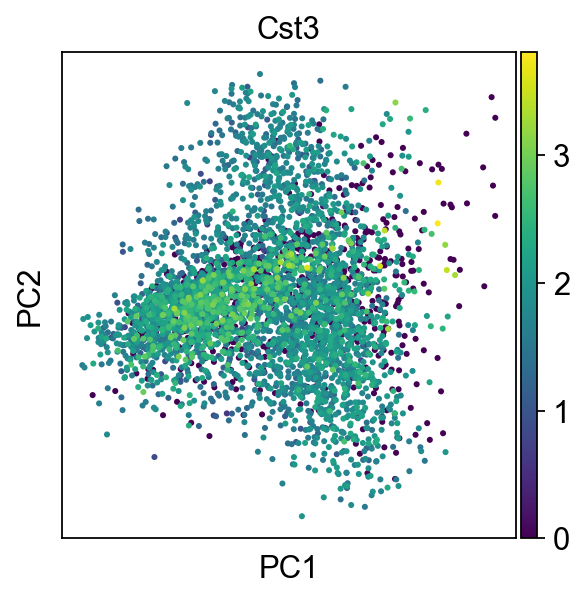

In [51]:
sc.pl.pca(adata, color='Cst3')

Let us inspect the contribution of single PCs to the total variance in the data. This gives us information about how many PCs we should consider in order to compute the neighborhood relations of cells, e.g. used in the clustering function  `sc.tl.louvain()` or tSNE `sc.tl.tsne()`. In our experience, often a rough estimate of the number of PCs does fine.

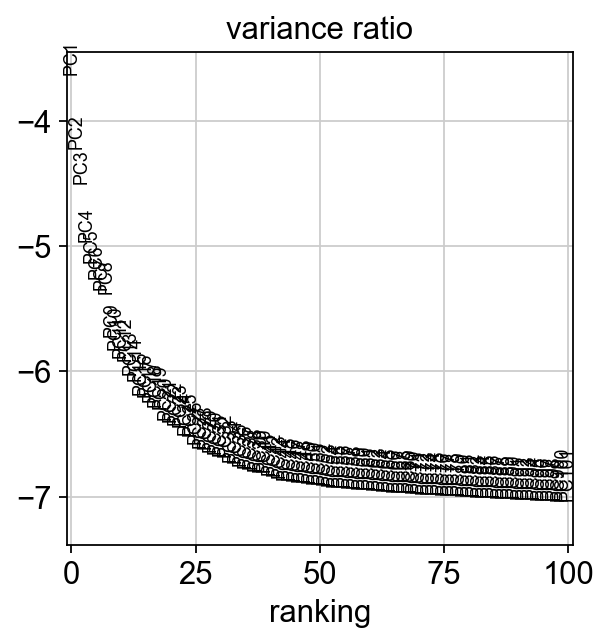

In [52]:
sc.pl.pca_variance_ratio(adata, log=True,n_pcs=100)

Save the result.

In [53]:
adata.write(results_file, compression='gzip')

In [54]:
adata

AnnData object with n_obs × n_vars = 4037 × 3715
    obs: 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'log10GenesPerUMI', 'Classification', 'n_counts', 'batch', 'Group'
    var: 'gene_ids', 'feature_types', 'genome', 'mt', 'n_cells-lane1', 'n_cells_by_counts-lane1', 'mean_counts-lane1', 'pct_dropout_by_counts-lane1', 'total_counts-lane1', 'highly_variable-lane1', 'means-lane1', 'dispersions-lane1', 'dispersions_norm-lane1', 'n_cells-lane1_rerun', 'n_cells_by_counts-lane1_rerun', 'mean_counts-lane1_rerun', 'pct_dropout_by_counts-lane1_rerun', 'total_counts-lane1_rerun', 'highly_variable-lane1_rerun', 'means-lane1_rerun', 'dispersions-lane1_rerun', 'dispersions_norm-lane1_rerun', 'n_cells-lane2', 'n_cells_by_counts-lane2', 'mean_counts-lane2', 'pct_dropout_by_counts-lane2', 'total_counts-lane2', 'highly_variable-lane2', 'means-lane2', 'dispersions-lane2', 'dispersions_norm-lane2', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean

## Computing the neighborhood graph

Let us compute the neighborhood graph of cells using the PCA representation of the data matrix. You might simply use default values here. For the sake of reproducing Seurat's results, let's take the following values.

In [55]:
sc.pp.neighbors(adata, n_neighbors=15, n_pcs=60)

computing neighbors
    using 'X_pca' with n_pcs = 60
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:00)


## Embedding the neighborhood graph

We suggest embedding the graph in two dimensions using UMAP ([McInnes et al., 2018](https://arxiv.org/abs/1802.03426)), see below. It is potentially more faithful to the global connectivity of the manifold than tSNE, i.e., it better preserves trajectories. In some ocassions, you might still observe disconnected clusters and similar connectivity violations. They can usually be remedied by running:

```
tl.paga(adata)
pl.paga(adata, plot=False)  # remove `plot=False` if you want to see the coarse-grained graph
tl.umap(adata, init_pos='paga')
```

In [56]:
sc.tl.umap(adata)

computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:05)


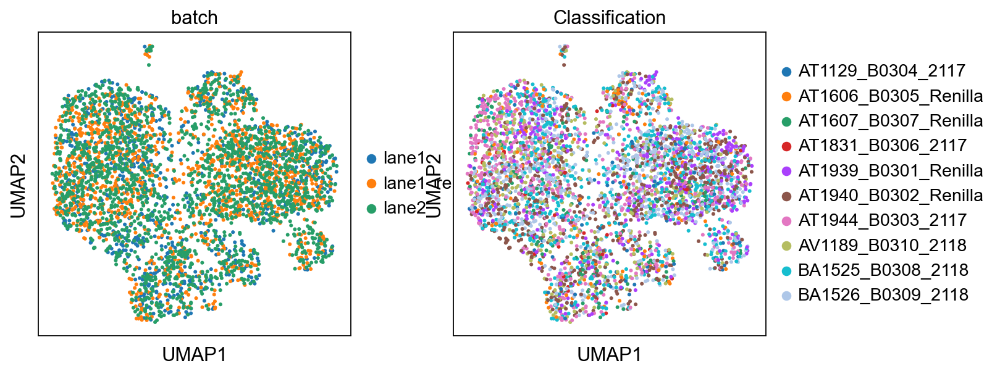

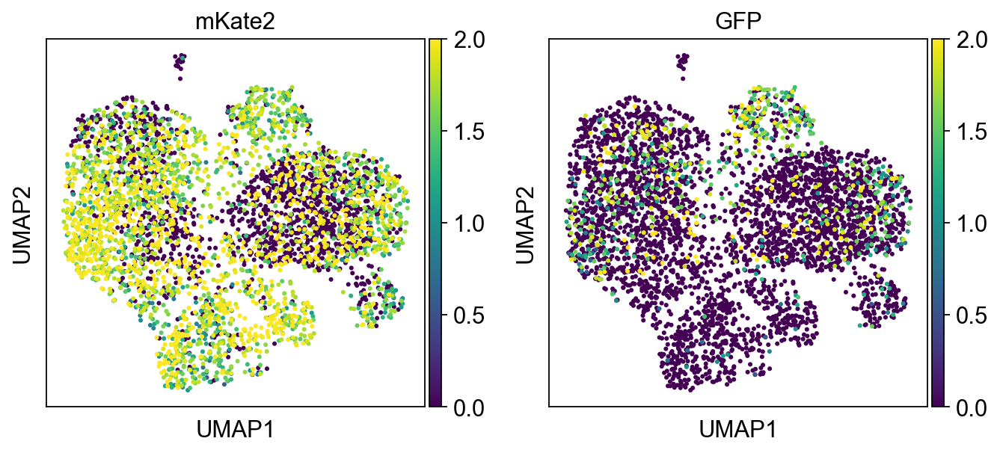

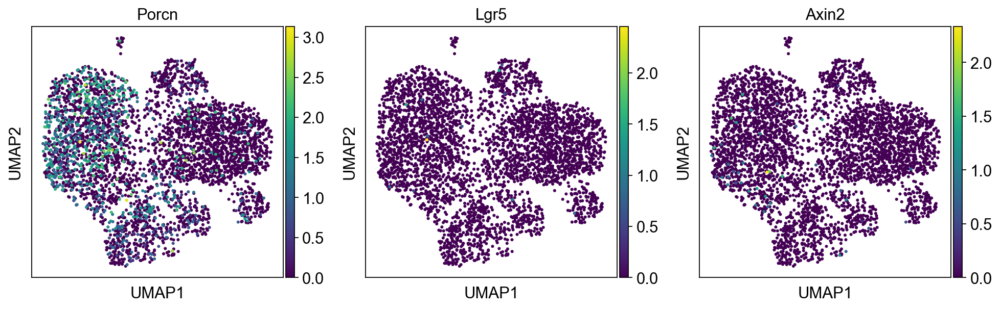

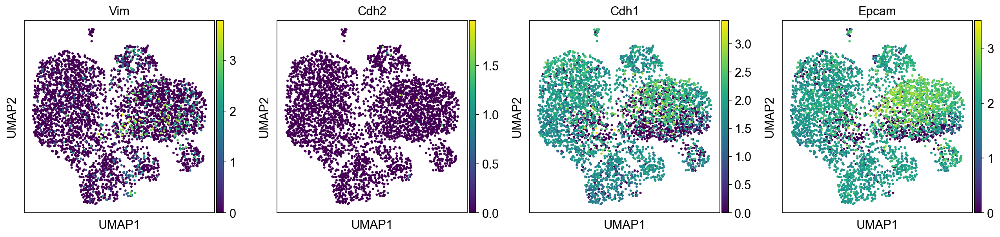

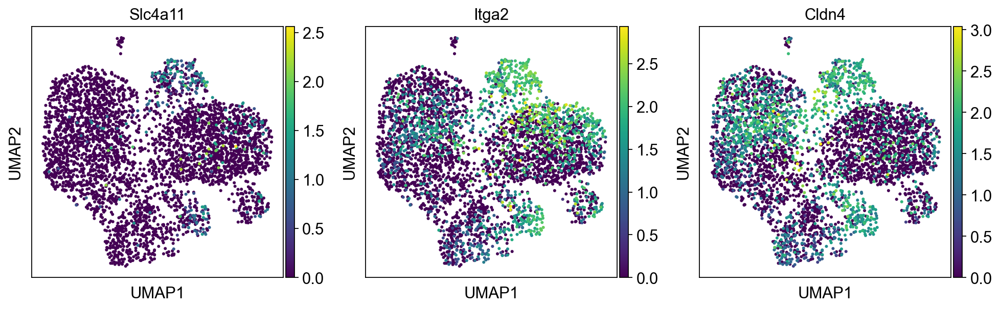

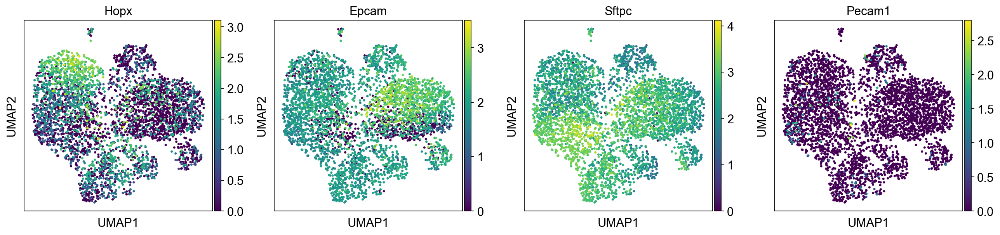

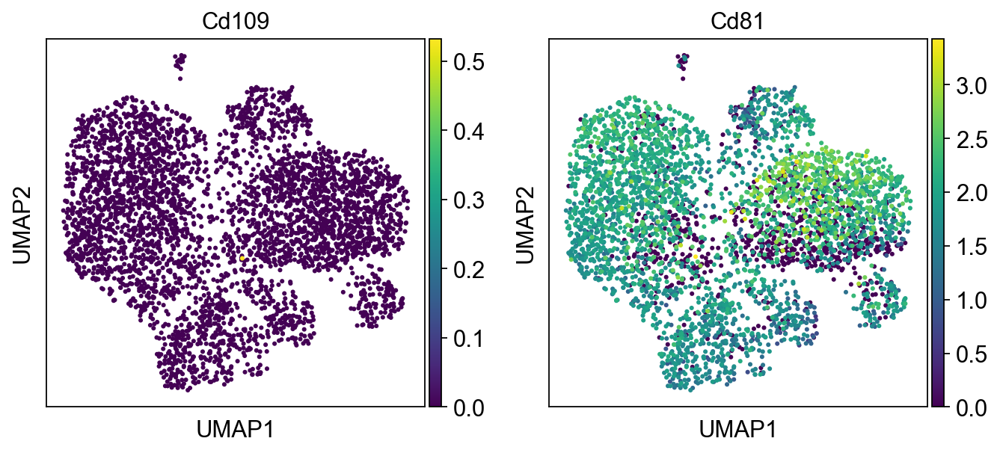

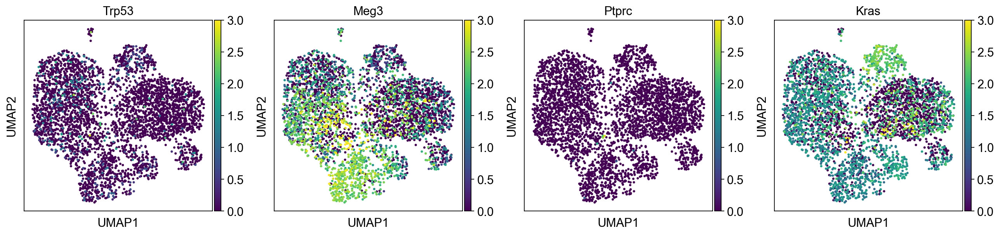

In [57]:
sc.pl.umap(adata, color=['batch', 'Classification'])
sc.pl.umap(adata, color=['mKate2', 'GFP'],vmax=2)#'shRNA'
sc.pl.umap(adata, color=['Porcn', 'Lgr5','Axin2']) #LGR6 not found
sc.pl.umap(adata, color=['Vim', 'Cdh2','Cdh1','Epcam']) #CDH1,EPCAM not found
sc.pl.umap(adata, color=['Slc4a11','Itga2', 'Cldn4'])
sc.pl.umap(adata, color=['Hopx','Epcam','Sftpc','Pecam1'])
sc.pl.umap(adata, color=['Cd109', 'Cd81'])
sc.pl.umap(adata, color=['Trp53','Meg3','Ptprc', 'Kras'], vmax=3)


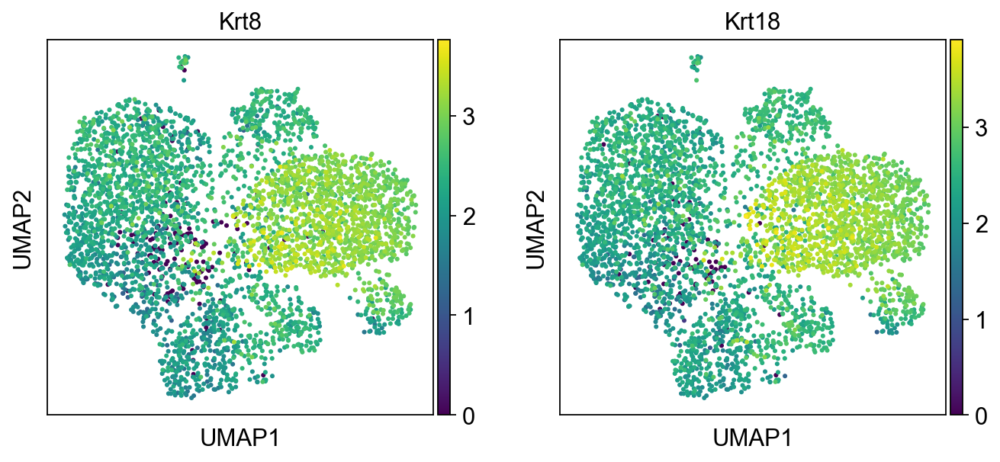

In [58]:
sc.pl.umap(adata, color=['Krt8', 'Krt18'])

In [69]:
sc.tl.leiden(adata, resolution=0.4)

running Leiden clustering
    finished: found 6 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:00:00)


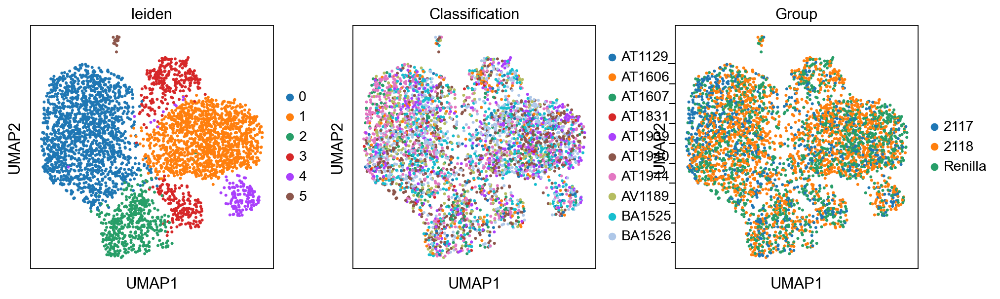

In [70]:
sc.pl.umap(adata, color = ['leiden', 'Classification', 'Group'])

ranking genes
    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:09)


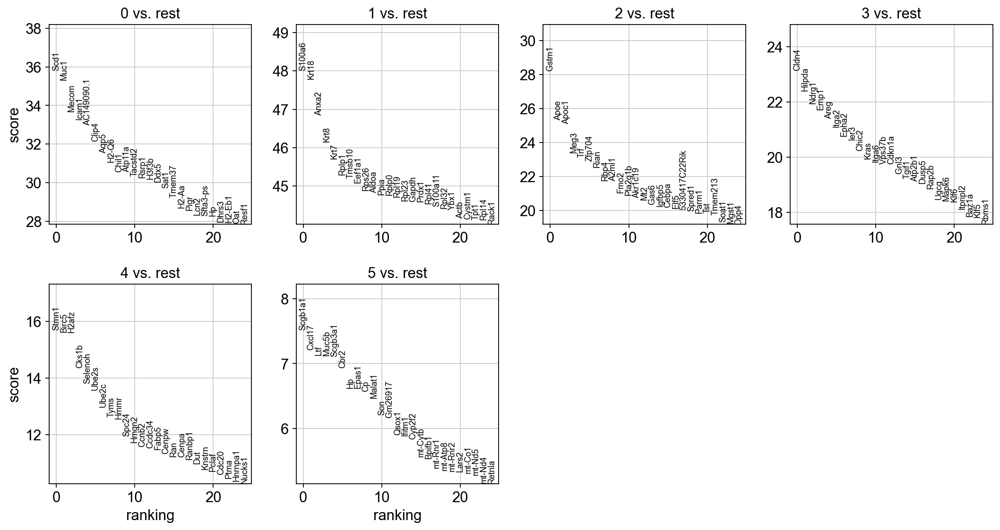

    using 'X_pca' with n_pcs = 150
Storing dendrogram info using `.uns['dendrogram_leiden']`


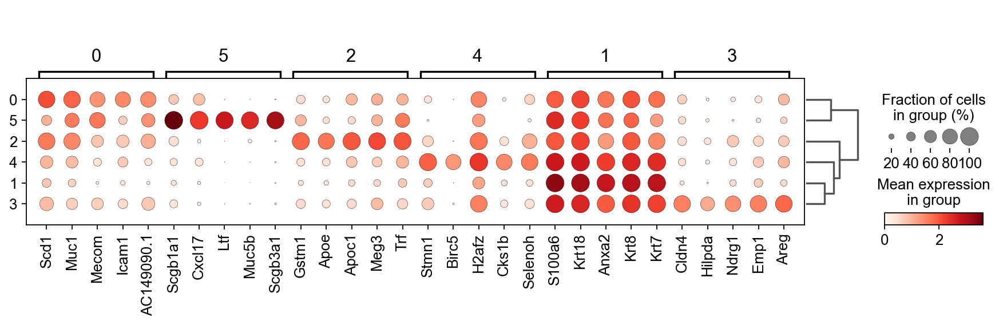

In [71]:
sc.tl.rank_genes_groups(adata, 'leiden', method='wilcoxon')
sc.pl.rank_genes_groups(adata, n_genes=25, sharey=False)
sc.pl.rank_genes_groups_dotplot(adata, n_genes=5, groupby="leiden")

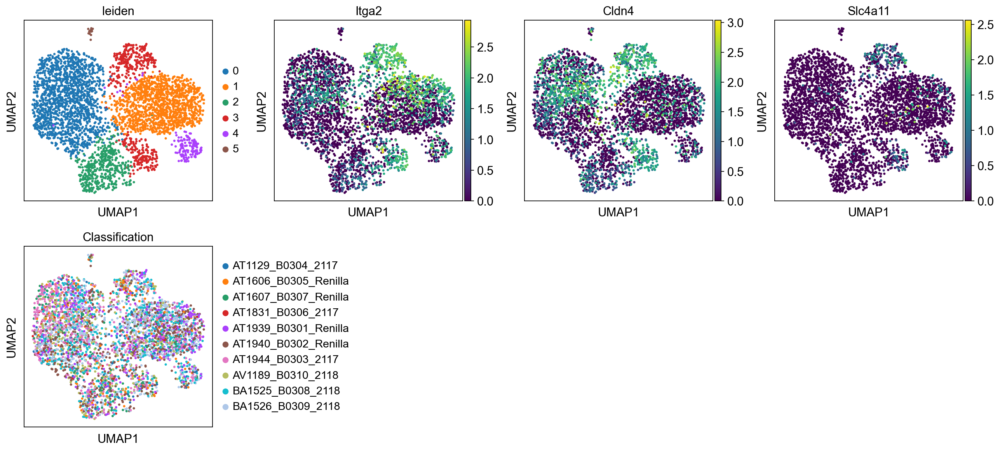

In [72]:
sc.pl.umap(adata, color=['leiden', 'Itga2', 'Cldn4', 'Slc4a11','Classification'])

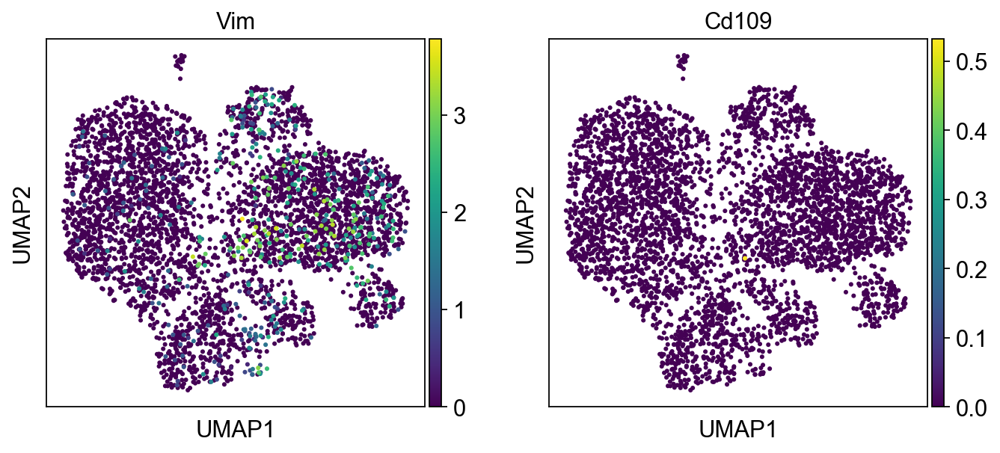

In [73]:
sc.pl.umap(adata, color=['Vim','Cd109'])

In [74]:
sc.tl.embedding_density(adata, basis='umap', groupby='Group')

computing density on 'umap'
--> added
    'umap_density_Group', densities (adata.obs)
    'umap_density_Group_params', parameter (adata.uns)


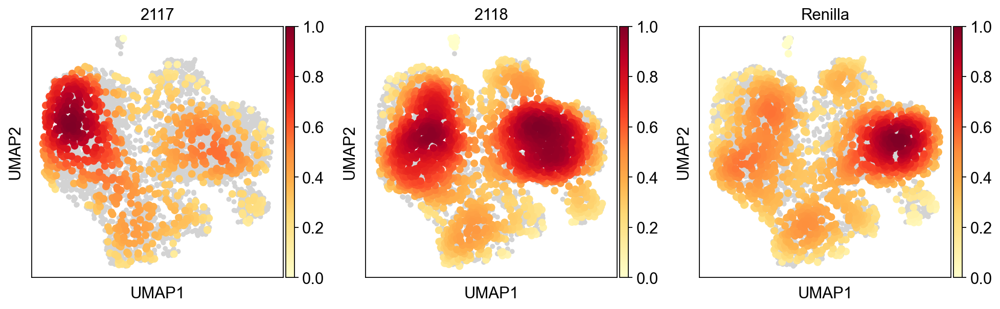

In [75]:
sc.pl.embedding_density(adata, basis='umap', key='umap_density_Group')

In [76]:
adata.obs.Group.value_counts()

2118       1791
Renilla    1458
2117        788
Name: Group, dtype: int64

In [77]:
result = adata.uns['rank_genes_groups']
groups = result['names'].dtype.names
pd.DataFrame(
    {group + '_' + key[:1]: result[key][group]
    for group in groups for key in ['names', 'scores', 'pvals_adj']}).to_excel('write/topGenesall.pvalue.xlsx')
pd.DataFrame(
    {group + '_' + key[:1]: result[key][group]
    for group in groups for key in ['names', 'pvals']}).head(5)

,0_n,0_p,1_n,1_p,2_n,2_p,3_n,3_p,4_n,4_p,5_n,5_p
0,Scd1,7.353504e-281,S100a6,0.0,Gstm1,1.930548e-175,Cldn4,1.731561e-118,Stmn1,1.439175e-55,Scgb1a1,5.600201e-14
1,Muc1,2.339531e-273,Krt18,0.0,Apoe,2.540133e-141,Hilpda,2.920712e-111,Birc5,4.161022e-55,Cxcl17,5.526306e-13
2,Mecom,1.423217e-248,Anxa2,0.0,Apoc1,6.684511e-139,Ndrg1,9.788438e-107,H2afz,5.801635e-55,Ltf,9.893695e-13
3,Icam1,1.081522e-242,Krt8,0.0,Meg3,4.926034e-121,Emp1,1.440896e-104,Cks1b,8.791251e-47,Muc5b,1.051497e-12
4,AC149090.1,2.253651e-238,Krt7,0.0,Trf,3.589523e-118,Areg,1.507455e-101,Selenoh,2.065249e-43,Scgb3a1,1.150695e-12


In [78]:
# Score Cluster 5 cells
import csv
clusters = {}
clusterkeys = []
HPCS = False

def resetClusters(hpcs = 'cell2020'):
    clusters = {}
    clusterkeys = []
    HPCS = False
    try:
        if hpcs == 'tumorClusters':
            with open('clusters/tumorClustersv2.csv',encoding='utf-8-sig') as csvfile:
                csvreader = csv.reader(csvfile, delimiter=",")
                for row in csvreader:
                    clusters[row[0]] = row[1:]
            for i in range(0,16):
                clusterkeys.append('%i' % i)
            HPCS = '3'
        elif hpcs == 'cell2020':         
            with open('clusters/clusters_cell2020.csv',encoding='utf-8-sig') as csvfile:
                csvreader = csv.reader(csvfile, delimiter=",")
                for row in csvreader:
                    clusters[row[0]] = row[1:]
            for i in range(1,13):
                #if i == 9: continue
                clusterkeys.append('Cluster %i' % i)
            HPCS = 'Cluster 5'
        elif hpcs == 'cl5bootstrap':
            with open('clusters/cl5bootstrap.csv',encoding='utf-8-sig') as csvfile:
                csvreader = csv.reader(csvfile, delimiter=",")
                for row in csvreader:
                    clusters[row[0]] = row[1:]
            #for i in range(0,1):
                #clusterkeys.append('%i' % i)
            clusterkeys.append('Cl5Bootstrap')
            HPCS = 'Cl5Bootstrap'
        elif hpcs == 'cl5bootstrap2':
            with open('clusters/cl5bootstrap2.csv',encoding='utf-8-sig') as csvfile:
                csvreader = csv.reader(csvfile, delimiter=",")
                for row in csvreader:
                    clusters[row[0]] = row[1:]
            #for i in range(0,1):
                #clusterkeys.append('%i' % i)
            clusterkeys.append('Cl5Bootstrap2')
            HPCS = 'Cl5Bootstrap2'
        elif hpcs == 'shRenilla':
            raise ValueError
            ###
        else:
            raise ValueError
    except ValueError:
        print("%s is an invalid choice" % hpcs)
        raise
    return (clusters, clusterkeys, HPCS)

(clusters, clusterkeys, HPCS) = resetClusters('cell2020')

In [79]:
def scoreAndPlot(ad, excludeList = None, groupby="Classification",rotation=90,numGenes=250):
    #cmap = 'Reds' #colormap
    cmap = 'jet' #colormap
    if excludeList == None:
        for i in clusterkeys:
            sc.tl.score_genes(ad, clusters[i][0:numGenes],score_name="%s" % i,ctrl_size=50,n_bins=50)  
        #sc.tl.score_genes(ad, clusters['Highly_mixed'],score_name="Highly_mixed")
  
        sc.pl.umap(ad, color=clusterkeys, color_map=cmap)
        #sc.pl.violin(ad, ['SLC4A11','ITGA2','CLDN4','TGIF1','Cluster5'],
         #   jitter=0.4, multi_panel=True, groupby=groupby, rotation=rotation)     
        #sc.pl.violin(ad, ['Highly_mixed'],
        #    jitter=0.4, multi_panel=True, groupby=groupby, rotation=rotation)            
        #sc.pl.violin(ad, ['MYC_sig','MYC','Fredlund','Jung'],
        #    jitter=0.4, multi_panel=True, groupby=groupby, rotation=rotation)     
        #sc.pl.violin(ad, ['ONECUT2','ONECUT2_369_sig','ONECUT2_29_sig'],
        #    jitter=0.4, multi_panel=True, groupby=groupby, rotation=rotation) 
        #sc.pl.violin(ad, ['YAP1', 'TAZ', 'YAP_sig'],
        #    jitter=0.4, multi_panel=True, groupby=groupby, rotation=rotation) 
        sc.pl.dotplot(ad, clusterkeys, groupby=groupby, swap_axes=True)
        sc.pl.violin(ad, [HPCS], groupby=groupby, swap_axes=True, rotation=90,stripplot=False, inner='box')

In [80]:
from scipy.stats import ranksums

def HPCSViolinPlot(ad, cluster='0', groupby='leiden', score='Cluster5', save=None, singleGene=False):
    ad.obs['Cl5'] = 'not HPCS'
    ad.obs.loc[ad.obs[groupby].isin([cluster]), 'Cl5'] = 'HPCS'

    if singleGene:
        pvalue = ranksums(ad[ad.obs['Cl5'].isin(['HPCS'])][:,score].X.toarray(),ad[~ad.obs['Cl5'].isin(['HPCS'])][:,score].X.toarray())[1]
        #sc.pl.violin(ad, score, groupby='Cl5', xlabel = 'p = ' + str(pvalue), save=save)
    else:
        pvalue = ranksums(ad[ad.obs['Cl5'].isin(['HPCS'])].obs[score],ad[ad.obs['Cl5'].isin(['not HPCS'])].obs[score])[1]
    sc.pl.violin(ad, score, groupby='Cl5', xlabel = 'p = ' + str(pvalue), save=save)

computing score 'Cluster 1'
    finished: added
    'Cluster 1', score of gene set (adata.obs).
    1676 total control genes are used. (0:00:00)
computing score 'Cluster 2'


/Users/chanj2/opt/miniconda3/envs/scanalysis202208/lib/python3.10/site-packages/scanpy/tools/_score_genes.py:151: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  for cut in np.unique(obs_cut.loc[gene_list]):
/Users/chanj2/opt/miniconda3/envs/scanalysis202208/lib/python3.10/site-packages/scanpy/tools/_score_genes.py:151: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  for cut in np.unique(obs_cut.loc[gene_list]):


    finished: added
    'Cluster 2', score of gene set (adata.obs).
    1140 total control genes are used. (0:00:00)
computing score 'Cluster 3'
    finished: added
    'Cluster 3', score of gene set (adata.obs).
    1535 total control genes are used. (0:00:00)
computing score 'Cluster 4'


/Users/chanj2/opt/miniconda3/envs/scanalysis202208/lib/python3.10/site-packages/scanpy/tools/_score_genes.py:151: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  for cut in np.unique(obs_cut.loc[gene_list]):
/Users/chanj2/opt/miniconda3/envs/scanalysis202208/lib/python3.10/site-packages/scanpy/tools/_score_genes.py:151: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  for cut in np.unique(obs_cut.loc[gene_list]):


    finished: added
    'Cluster 4', score of gene set (adata.obs).
    1447 total control genes are used. (0:00:00)
computing score 'Cluster 5'
    finished: added
    'Cluster 5', score of gene set (adata.obs).
    1722 total control genes are used. (0:00:00)
computing score 'Cluster 6'


/Users/chanj2/opt/miniconda3/envs/scanalysis202208/lib/python3.10/site-packages/scanpy/tools/_score_genes.py:151: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  for cut in np.unique(obs_cut.loc[gene_list]):
/Users/chanj2/opt/miniconda3/envs/scanalysis202208/lib/python3.10/site-packages/scanpy/tools/_score_genes.py:151: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  for cut in np.unique(obs_cut.loc[gene_list]):


    finished: added
    'Cluster 6', score of gene set (adata.obs).
    1975 total control genes are used. (0:00:00)
computing score 'Cluster 7'
    finished: added
    'Cluster 7', score of gene set (adata.obs).
    1621 total control genes are used. (0:00:00)
computing score 'Cluster 8'


/Users/chanj2/opt/miniconda3/envs/scanalysis202208/lib/python3.10/site-packages/scanpy/tools/_score_genes.py:151: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  for cut in np.unique(obs_cut.loc[gene_list]):
/Users/chanj2/opt/miniconda3/envs/scanalysis202208/lib/python3.10/site-packages/scanpy/tools/_score_genes.py:151: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  for cut in np.unique(obs_cut.loc[gene_list]):


    finished: added
    'Cluster 8', score of gene set (adata.obs).
    1674 total control genes are used. (0:00:00)
computing score 'Cluster 9'
    finished: added
    'Cluster 9', score of gene set (adata.obs).
    2262 total control genes are used. (0:00:00)
computing score 'Cluster 10'


/Users/chanj2/opt/miniconda3/envs/scanalysis202208/lib/python3.10/site-packages/scanpy/tools/_score_genes.py:151: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  for cut in np.unique(obs_cut.loc[gene_list]):
/Users/chanj2/opt/miniconda3/envs/scanalysis202208/lib/python3.10/site-packages/scanpy/tools/_score_genes.py:151: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  for cut in np.unique(obs_cut.loc[gene_list]):


    finished: added
    'Cluster 10', score of gene set (adata.obs).
    2180 total control genes are used. (0:00:00)
computing score 'Cluster 11'
    finished: added
    'Cluster 11', score of gene set (adata.obs).
    2231 total control genes are used. (0:00:00)
computing score 'Cluster 12'


/Users/chanj2/opt/miniconda3/envs/scanalysis202208/lib/python3.10/site-packages/scanpy/tools/_score_genes.py:151: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  for cut in np.unique(obs_cut.loc[gene_list]):
/Users/chanj2/opt/miniconda3/envs/scanalysis202208/lib/python3.10/site-packages/scanpy/tools/_score_genes.py:151: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  for cut in np.unique(obs_cut.loc[gene_list]):


    finished: added
    'Cluster 12', score of gene set (adata.obs).
    2130 total control genes are used. (0:00:00)


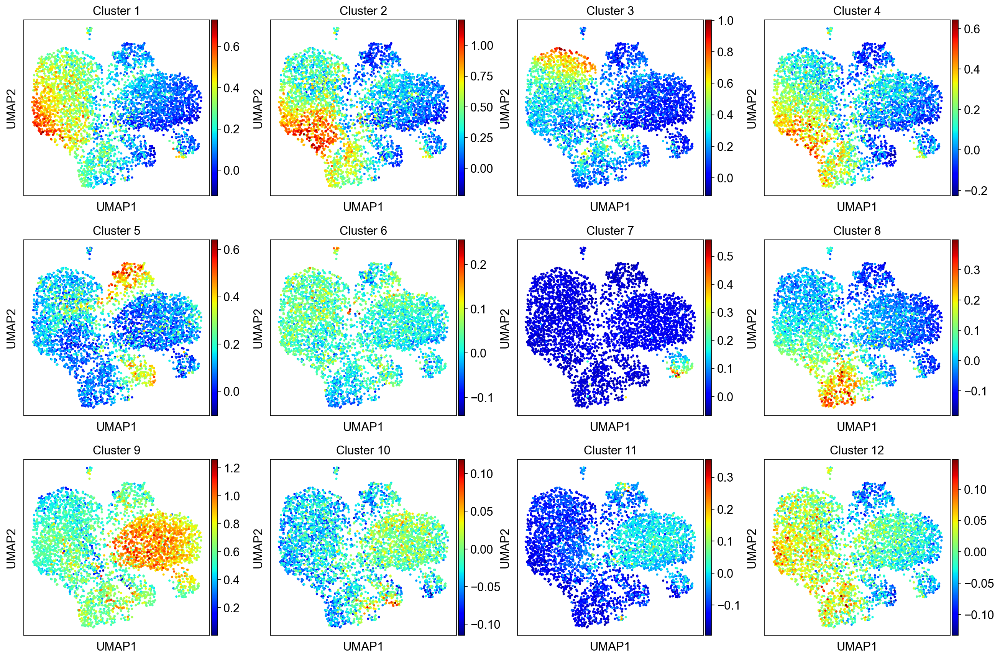

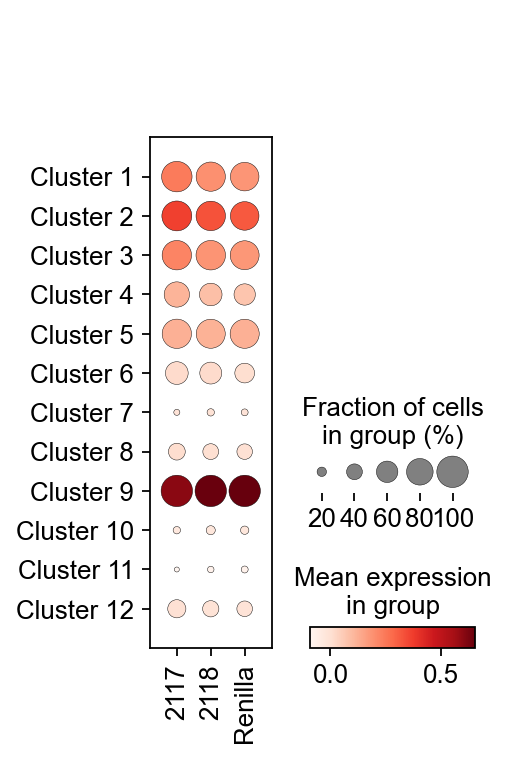

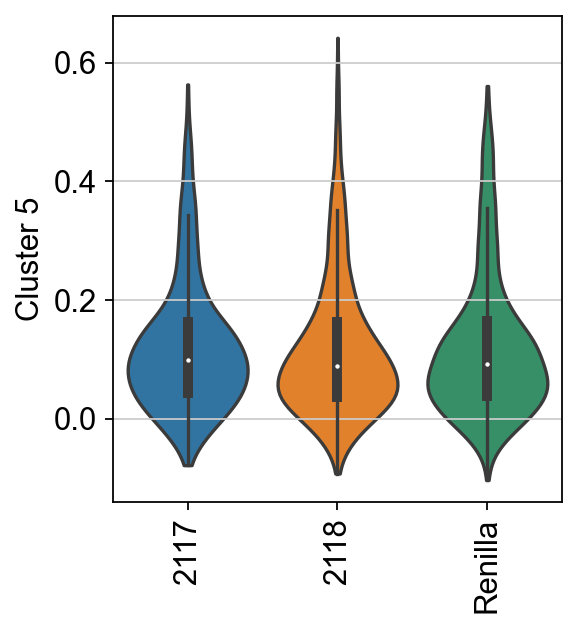

In [81]:
scoreAndPlot(adata, groupby='Group')

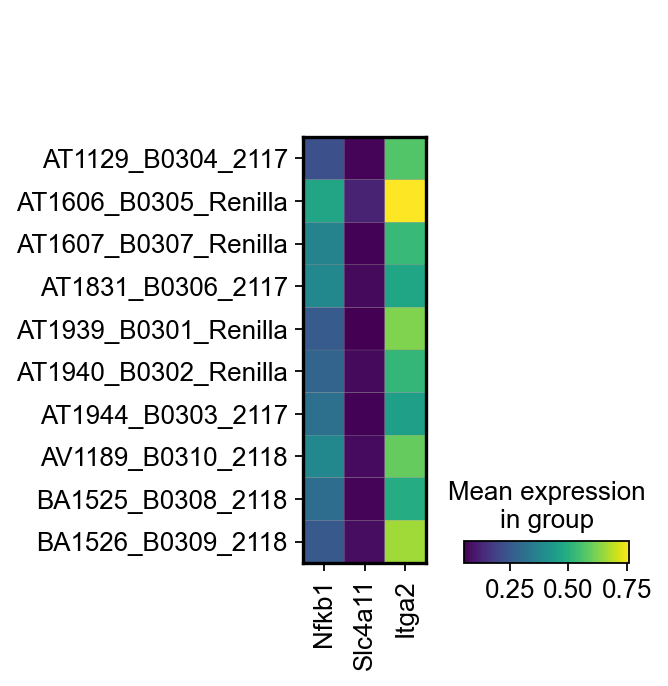

In [82]:
sc.pl.matrixplot(adata, ['Nfkb1','Slc4a11','Itga2',], groupby='Classification')

In [83]:
adata.obs.Group.value_counts()

2118       1791
Renilla    1458
2117        788
Name: Group, dtype: int64

computing score 'Cl5Bootstrap2'
    finished: added
    'Cl5Bootstrap2', score of gene set (adata.obs).
    938 total control genes are used. (0:00:00)


/Users/chanj2/opt/miniconda3/envs/scanalysis202208/lib/python3.10/site-packages/scanpy/tools/_score_genes.py:151: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  for cut in np.unique(obs_cut.loc[gene_list]):


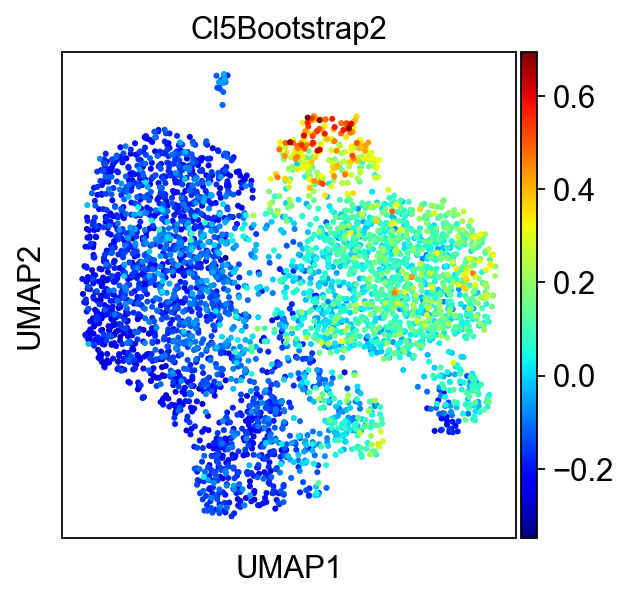

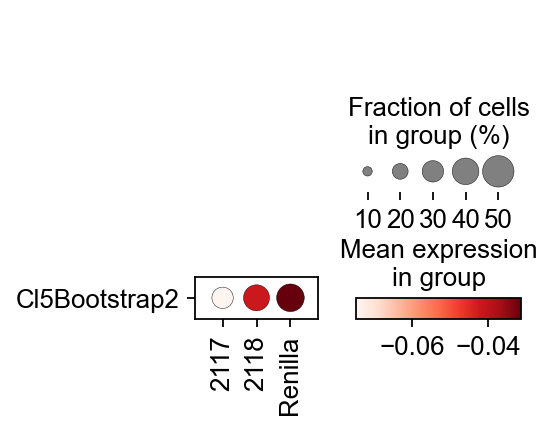

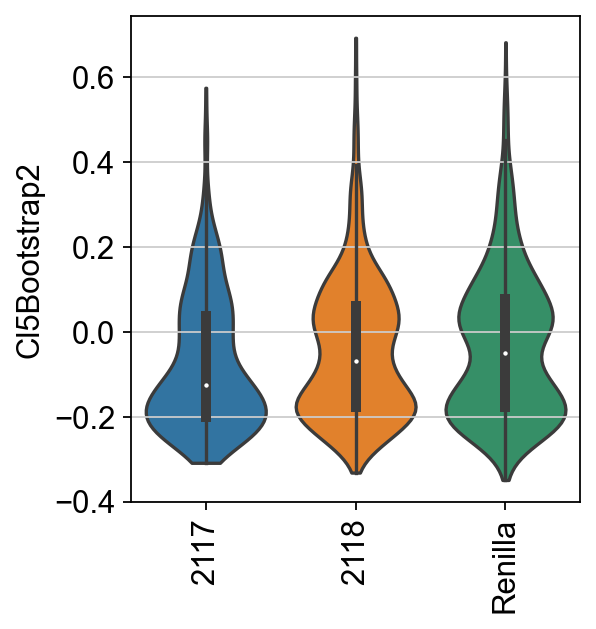

In [84]:
(clusters, clusterkeys, HPCS) = resetClusters('cl5bootstrap2')
scoreAndPlot(adata,numGenes=100, groupby='Group')

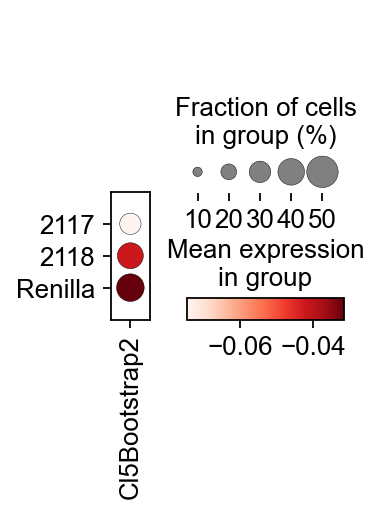

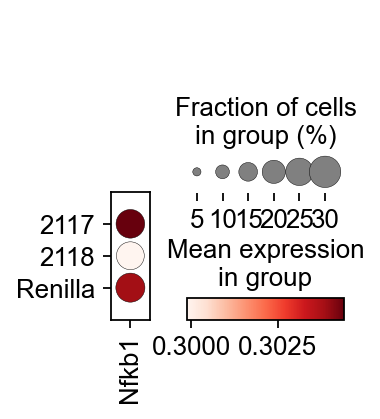

In [92]:
sc.pl.dotplot(adata, ['Cl5Bootstrap2'], groupby='Group')
sc.pl.dotplot(adata, ['Nfkb1'], groupby='Group')

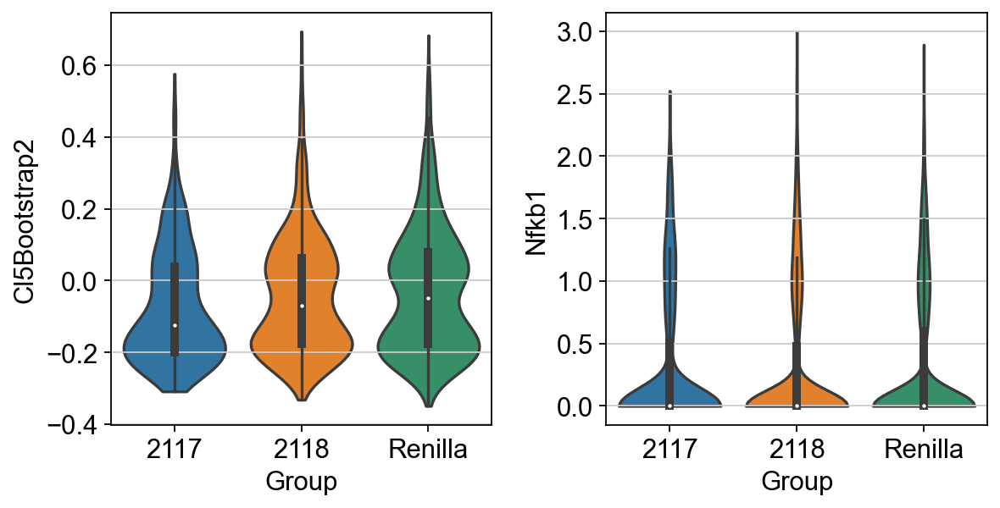

In [93]:
sc.pl.violin(adata,['Cl5Bootstrap2', 'Nfkb1'], groupby='Group',inner='box',stripplot=False)

In [94]:
adata.obs.Cl5Bootstrap2

AAACGAAAGTGTACCT-1-lane1   -0.172645
AAACGAAGTTTATGCG-1-lane1   -0.093689
AAAGAACTCCAACCAA-1-lane1   -0.254230
AAAGGATGTCGGTACC-1-lane1   -0.212294
AAAGGGCCAGCTCATA-1-lane1    0.173597
                              ...   
TTTGTTGAGACCATAA-1-lane2    0.301932
TTTGTTGAGATTCGCT-1-lane2    0.095908
TTTGTTGGTACAAGTA-1-lane2    0.048181
TTTGTTGTCGAGAAGC-1-lane2   -0.170734
TTTGTTGTCGTTCATT-1-lane2   -0.103481
Name: Cl5Bootstrap2, Length: 4037, dtype: float64

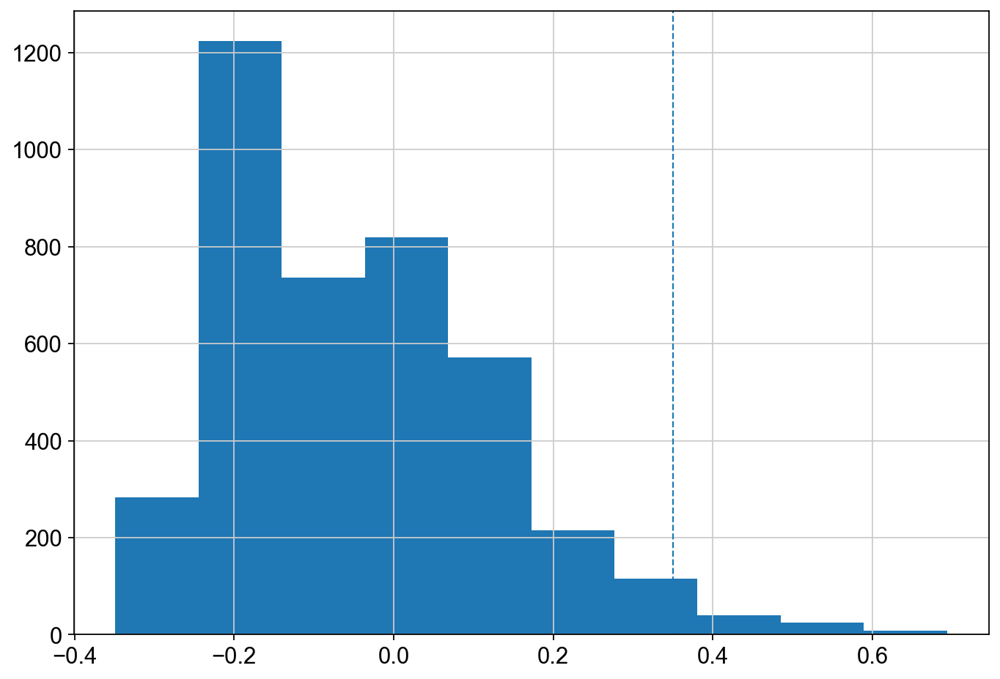

In [95]:
import matplotlib.pyplot as plt
fig, ax = plt.subplots(figsize =(10, 7))
ax.hist(adata.obs.Cl5Bootstrap2)
ax.axvline(0.35, linestyle='dashed', linewidth=1)
# Show plot
plt.show()
#adata = adata[adata.X[:,adata.var.index.isin(['Ptprc'])] < 0.5,:]

In [96]:
Cl5Cells = adata[adata.obs.Cl5Bootstrap2 >= 0.35,:].obs.index
notCl5Cells = adata[adata.obs.Cl5Bootstrap2 < 0.35,:].obs.index

In [97]:
adata.obs.Group.value_counts()

2118       1791
Renilla    1458
2117        788
Name: Group, dtype: int64

In [98]:
adata[Cl5Cells,:].obs.Group.value_counts()

Renilla    47
2118       43
2117        9
Name: Group, dtype: int64

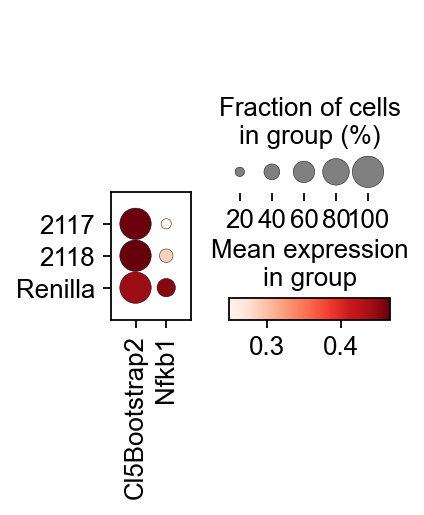

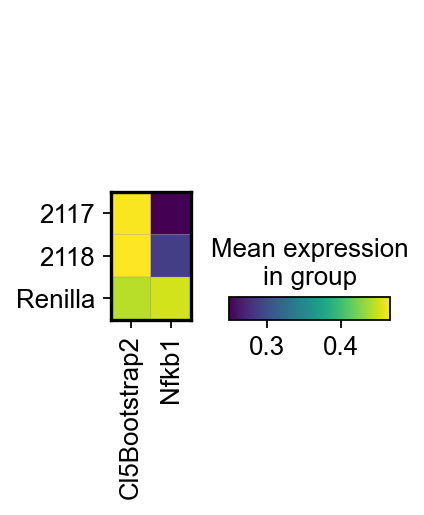

In [99]:
sc.pl.dotplot(adata[Cl5Cells,:], ['Cl5Bootstrap2', 'Nfkb1'], groupby='Group')
sc.pl.matrixplot(adata[Cl5Cells,:], ['Cl5Bootstrap2', 'Nfkb1'], groupby='Group')

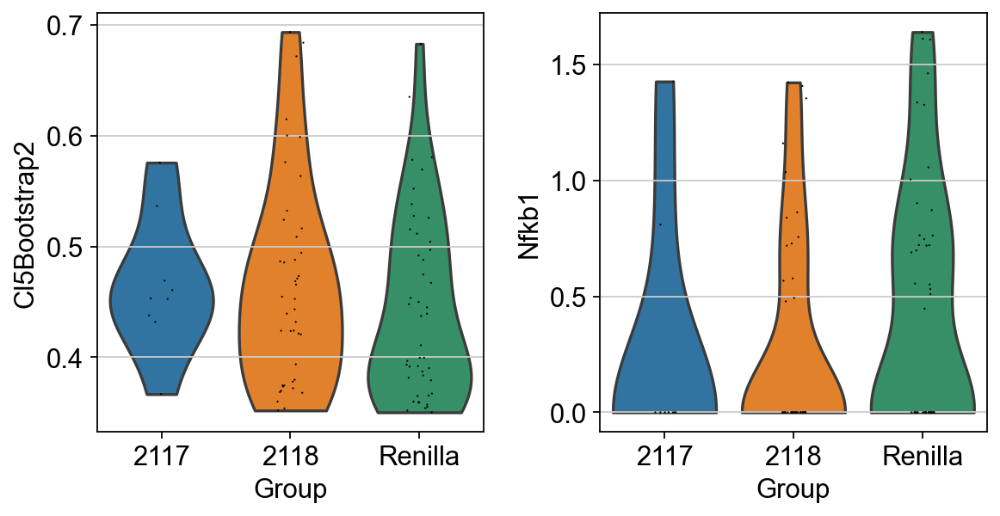

In [100]:
sc.pl.violin(adata[Cl5Cells,:], ['Cl5Bootstrap2', 'Nfkb1'], groupby='Group')

/Users/chanj2/opt/miniconda3/envs/scanalysis202208/lib/python3.10/site-packages/scanpy/plotting/_tools/__init__.py:1488: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs[density_col_name] = dens_values


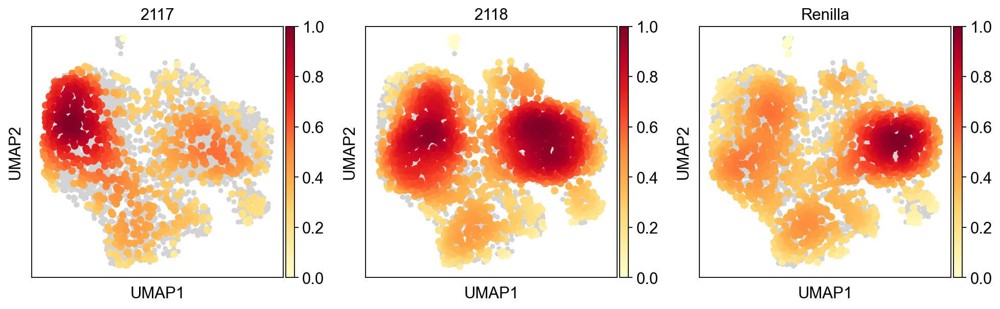

In [101]:
sc.pl.embedding_density(adata[notCl5Cells,:], basis='umap', key='umap_density_Group')

/Users/chanj2/opt/miniconda3/envs/scanalysis202208/lib/python3.10/site-packages/scanpy/plotting/_tools/__init__.py:1488: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs[density_col_name] = dens_values


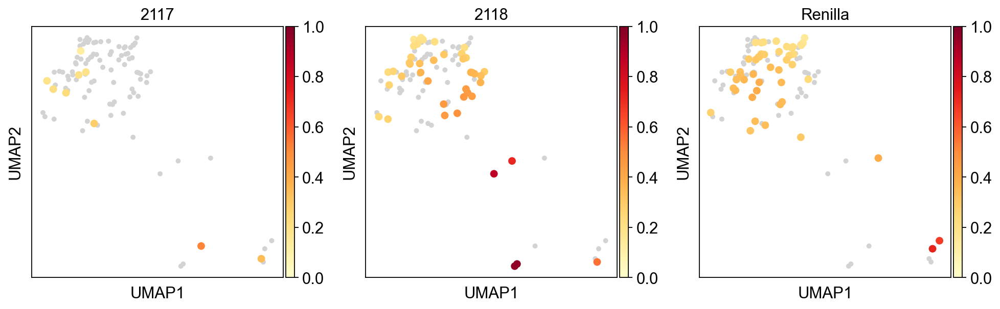

In [102]:
sc.pl.embedding_density(adata[Cl5Cells,:], basis='umap', key='umap_density_Group')

In [140]:
adata.obs.Group.value_counts()

2118       1791
Renilla    1458
2117        788
Name: Group, dtype: int64

## Subsample

In [141]:
s2118_subsample = sc.pp.subsample(adata[adata.obs.Group.isin(['2118']),:], n_obs=788, copy=True)
renilla_subsample = sc.pp.subsample(adata[adata.obs.Group.isin(['Renilla']),:], n_obs=788, copy=True)
nadata = adata[adata.obs.Group.isin(['2117']),:].concatenate(s2118_subsample, renilla_subsample)

/Users/chanj2/opt/miniconda3/envs/scanalysis202208/lib/python3.10/site-packages/anndata/_core/anndata.py:1785: FutureWarning: X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  [AnnData(sparse.csr_matrix(a.shape), obs=a.obs) for a in all_adatas],


computing score 'Cluster 1'
    finished: added
    'Cluster 1', score of gene set (adata.obs).
    1643 total control genes are used. (0:00:00)
computing score 'Cluster 2'
    finished: added
    'Cluster 2', score of gene set (adata.obs).
    1189 total control genes are used. (0:00:00)
computing score 'Cluster 3'


/Users/chanj2/opt/miniconda3/envs/scanalysis202208/lib/python3.10/site-packages/scanpy/tools/_score_genes.py:151: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  for cut in np.unique(obs_cut.loc[gene_list]):
/Users/chanj2/opt/miniconda3/envs/scanalysis202208/lib/python3.10/site-packages/scanpy/tools/_score_genes.py:151: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  for cut in np.unique(obs_cut.loc[gene_list]):
/Users/chanj2/opt/miniconda3/envs/scanalysis202208/lib/python3.10/site-packages/scanpy/tools/_score_genes.py:151: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  for cut in np.unique(obs_cut.loc[gene_list]):


    finished: added
    'Cluster 3', score of gene set (adata.obs).
    1435 total control genes are used. (0:00:00)
computing score 'Cluster 4'
    finished: added
    'Cluster 4', score of gene set (adata.obs).
    1391 total control genes are used. (0:00:00)
computing score 'Cluster 5'
    finished: added
    'Cluster 5', score of gene set (adata.obs).
    1636 total control genes are used. (0:00:00)
computing score 'Cluster 6'


/Users/chanj2/opt/miniconda3/envs/scanalysis202208/lib/python3.10/site-packages/scanpy/tools/_score_genes.py:151: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  for cut in np.unique(obs_cut.loc[gene_list]):
/Users/chanj2/opt/miniconda3/envs/scanalysis202208/lib/python3.10/site-packages/scanpy/tools/_score_genes.py:151: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  for cut in np.unique(obs_cut.loc[gene_list]):
/Users/chanj2/opt/miniconda3/envs/scanalysis202208/lib/python3.10/site-packages/scanpy/tools/_score_genes.py:151: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  for cut in np.unique(obs_cut.loc[gene_list]):


    finished: added
    'Cluster 6', score of gene set (adata.obs).
    1640 total control genes are used. (0:00:00)
computing score 'Cluster 7'
    finished: added
    'Cluster 7', score of gene set (adata.obs).
    1141 total control genes are used. (0:00:00)
computing score 'Cluster 8'
    finished: added
    'Cluster 8', score of gene set (adata.obs).
    1343 total control genes are used. (0:00:00)
computing score 'Cluster 9'
    finished: added
    'Cluster 9', score of gene set (adata.obs).
    1692 total control genes are used. (0:00:00)
computing score 'Cluster 10'


/Users/chanj2/opt/miniconda3/envs/scanalysis202208/lib/python3.10/site-packages/scanpy/tools/_score_genes.py:151: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  for cut in np.unique(obs_cut.loc[gene_list]):
/Users/chanj2/opt/miniconda3/envs/scanalysis202208/lib/python3.10/site-packages/scanpy/tools/_score_genes.py:151: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  for cut in np.unique(obs_cut.loc[gene_list]):
/Users/chanj2/opt/miniconda3/envs/scanalysis202208/lib/python3.10/site-packages/scanpy/tools/_score_genes.py:151: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  for cut in np.unique(obs_cut.loc[gene_list]):


    finished: added
    'Cluster 10', score of gene set (adata.obs).
    1637 total control genes are used. (0:00:00)
computing score 'Cluster 11'
    finished: added
    'Cluster 11', score of gene set (adata.obs).
    1590 total control genes are used. (0:00:00)
computing score 'Cluster 12'
    finished: added
    'Cluster 12', score of gene set (adata.obs).
    1540 total control genes are used. (0:00:00)


/Users/chanj2/opt/miniconda3/envs/scanalysis202208/lib/python3.10/site-packages/scanpy/tools/_score_genes.py:151: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  for cut in np.unique(obs_cut.loc[gene_list]):
/Users/chanj2/opt/miniconda3/envs/scanalysis202208/lib/python3.10/site-packages/scanpy/tools/_score_genes.py:151: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  for cut in np.unique(obs_cut.loc[gene_list]):
/Users/chanj2/opt/miniconda3/envs/scanalysis202208/lib/python3.10/site-packages/scanpy/tools/_score_genes.py:151: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  for cut in np.unique(obs_cut.loc[gene_list]):


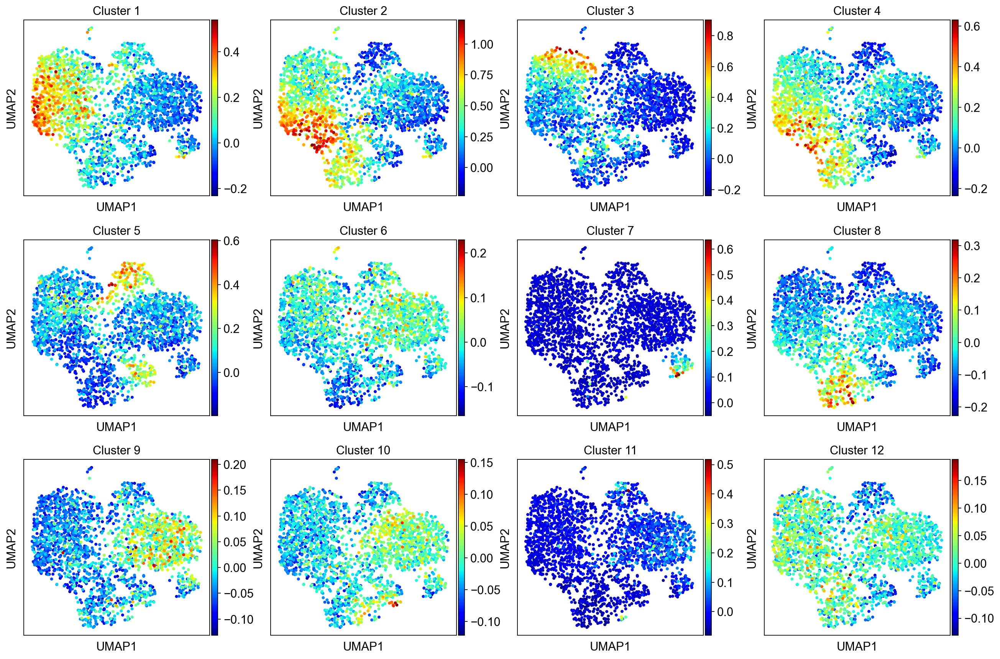

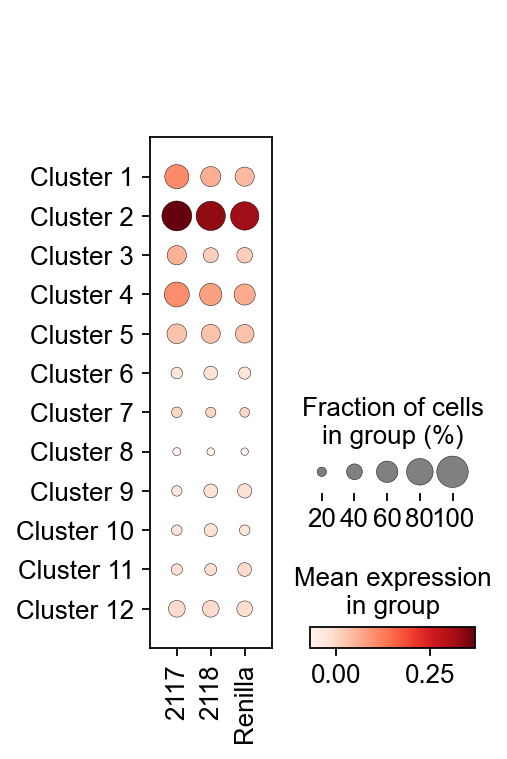

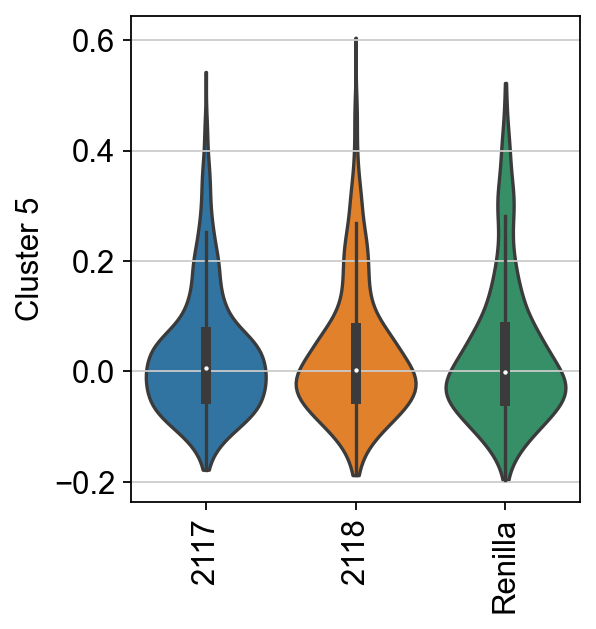

In [142]:
(clusters, clusterkeys, HPCS) = resetClusters('cell2020')
scoreAndPlot(nadata,numGenes=100, groupby='Group')

computing score 'Cl5Bootstrap2'
    finished: added
    'Cl5Bootstrap2', score of gene set (adata.obs).
    842 total control genes are used. (0:00:00)


/Users/chanj2/opt/miniconda3/envs/scanalysis202208/lib/python3.10/site-packages/scanpy/tools/_score_genes.py:151: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  for cut in np.unique(obs_cut.loc[gene_list]):


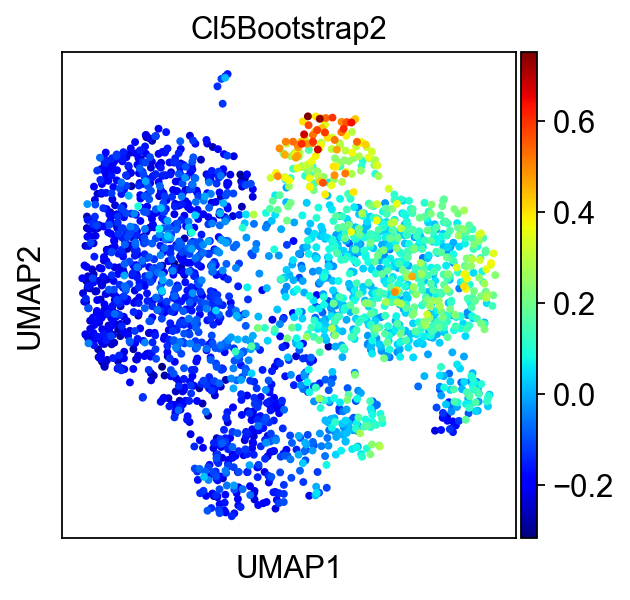

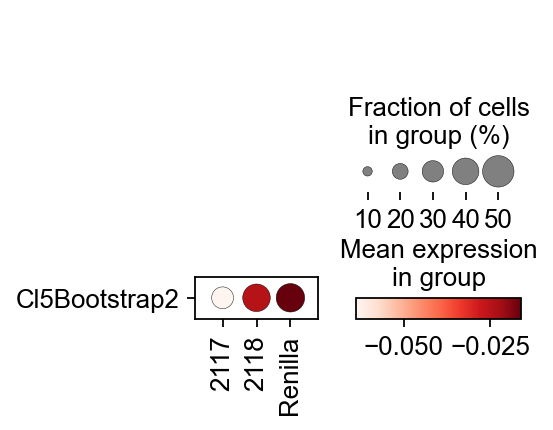

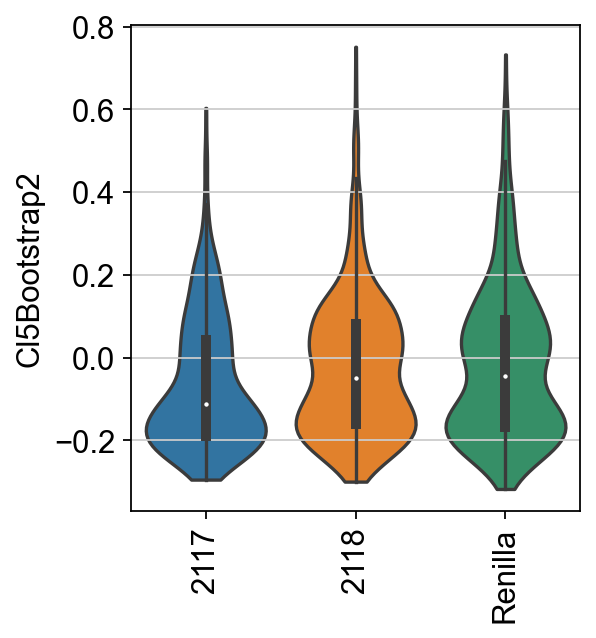

In [143]:
(clusters, clusterkeys, HPCS) = resetClusters('cl5bootstrap2')
scoreAndPlot(nadata,numGenes=100, groupby='Group')

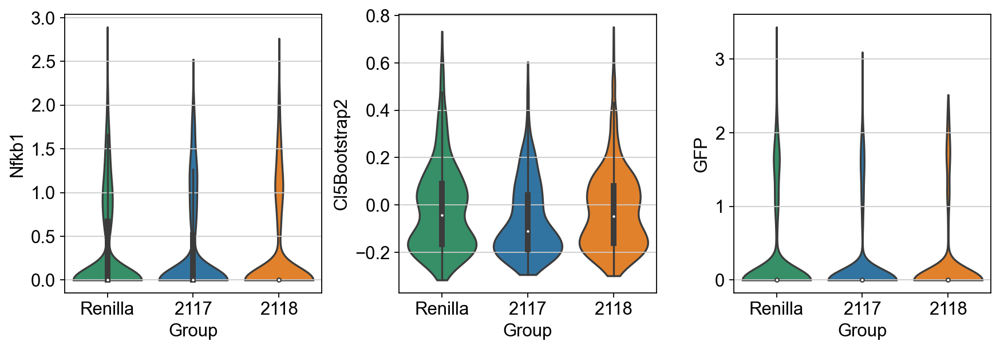

In [144]:
sc.pl.violin(nadata, ['Nfkb1', 'Cl5Bootstrap2','GFP'], groupby='Group', order=['Renilla','2117','2118'],
             stripplot=False,inner='box', save='HPCS Program.svg')

computing score 'Cl5Bootstrap2'
    finished: added
    'Cl5Bootstrap2', score of gene set (adata.obs).
    920 total control genes are used. (0:00:00)


/Users/chanj2/opt/miniconda3/envs/scanalysis202208/lib/python3.10/site-packages/scanpy/tools/_score_genes.py:151: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  for cut in np.unique(obs_cut.loc[gene_list]):


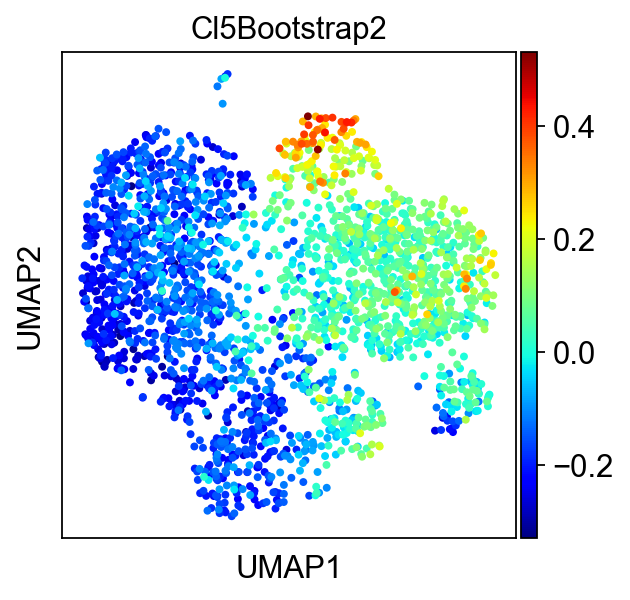

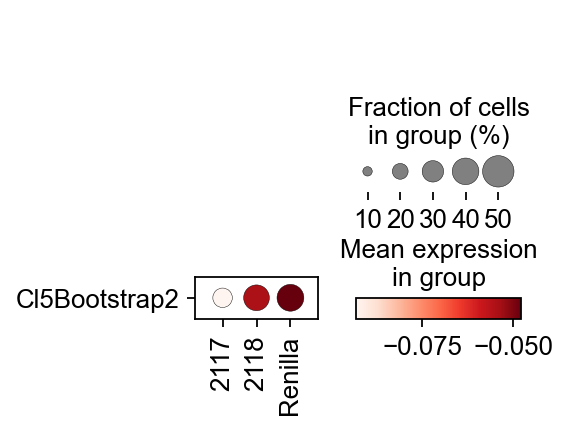

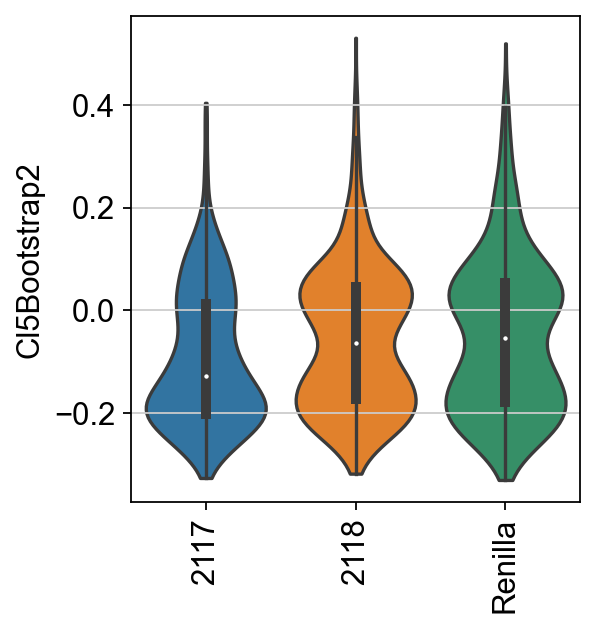

In [145]:
(clusters, clusterkeys, HPCS) = resetClusters('cl5bootstrap2')
scoreAndPlot(nadata, groupby='Group',numGenes=200)

In [146]:
import scipy.stats
print(scipy.stats.mannwhitneyu(nadata[nadata.obs['Group']=='Renilla',:].obs['Cl5Bootstrap2'],nadata[nadata.obs['Group']=='2117',:].obs['Cl5Bootstrap2']))
print(scipy.stats.mannwhitneyu(nadata[nadata.obs['Group']=='Renilla',:].obs['Cl5Bootstrap2'],nadata[nadata.obs['Group']=='2118',:].obs['Cl5Bootstrap2']))

MannwhitneyuResult(statistic=362787.0, pvalue=6.987378854327685e-09)
MannwhitneyuResult(statistic=315366.0, pvalue=0.5880171835756689)


In [147]:
nadata.obs.Group.value_counts()

2117       788
2118       788
Renilla    788
Name: Group, dtype: int64

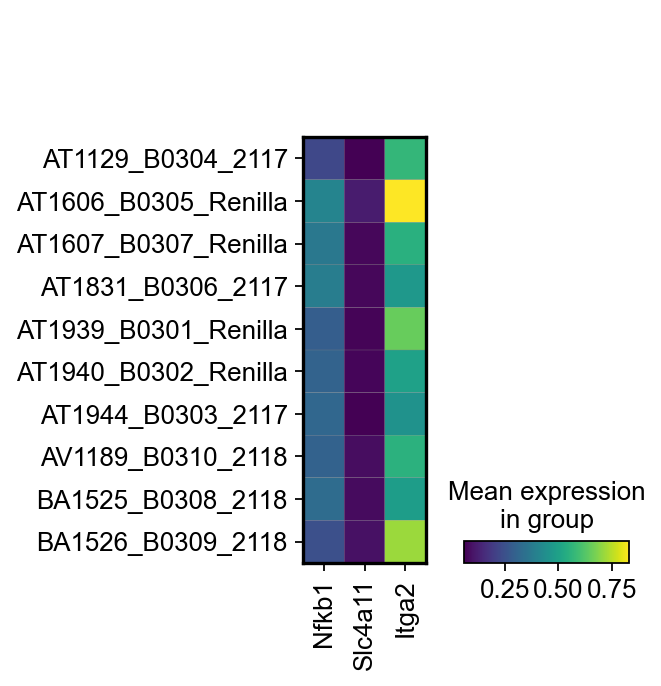

In [148]:
sc.pl.matrixplot(nadata, ['Nfkb1','Slc4a11','Itga2',], groupby='Classification')

In [149]:
nadata.obs.Classification.value_counts()

AT1944_B0303_2117       615
AT1940_B0302_Renilla    374
BA1526_B0309_2118       334
BA1525_B0308_2118       289
AT1939_B0301_Renilla    228
AV1189_B0310_2118       165
AT1129_B0304_2117       123
AT1607_B0307_Renilla    103
AT1606_B0305_Renilla     83
AT1831_B0306_2117        50
Name: Classification, dtype: int64

computing score 'Cl5Bootstrap2'
    finished: added
    'Cl5Bootstrap2', score of gene set (adata.obs).
    976 total control genes are used. (0:00:00)


/Users/chanj2/opt/miniconda3/envs/scanalysis202208/lib/python3.10/site-packages/scanpy/tools/_score_genes.py:151: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  for cut in np.unique(obs_cut.loc[gene_list]):


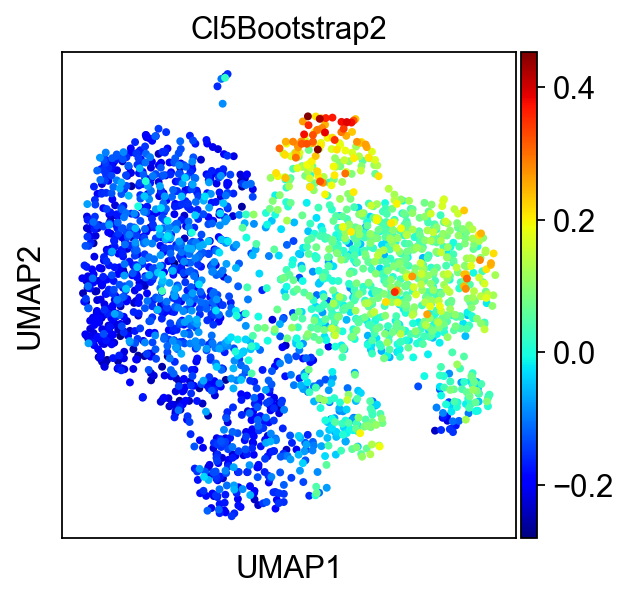

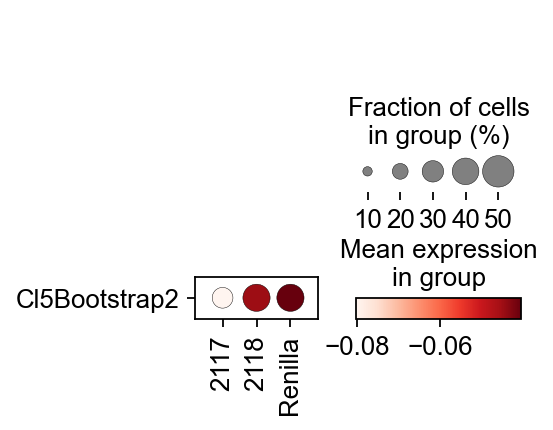

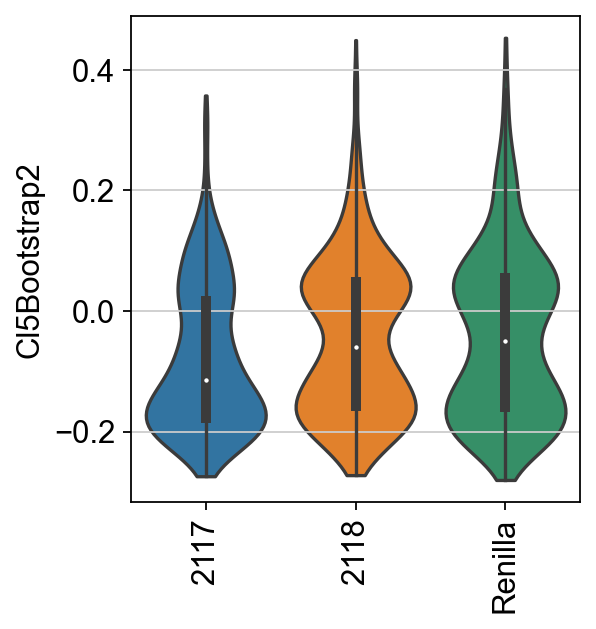

In [150]:
scoreAndPlot(nadata, groupby='Group')

In [151]:
sc.tl.embedding_density(nadata, basis='umap', groupby='Group')

computing density on 'umap'
--> added
    'umap_density_Group', densities (adata.obs)
    'umap_density_Group_params', parameter (adata.uns)


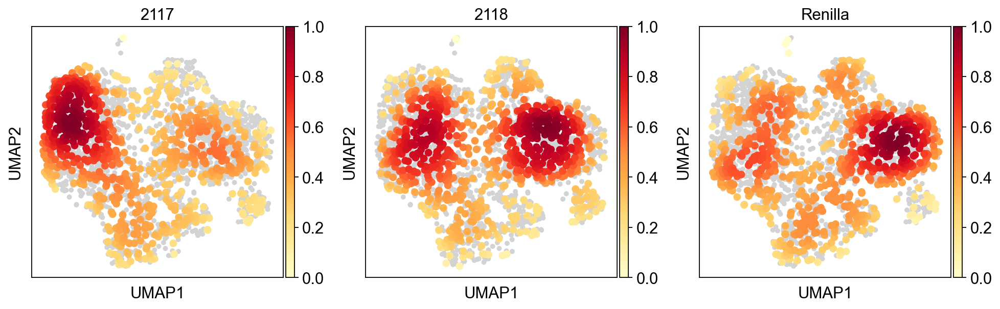

In [152]:
sc.pl.embedding_density(nadata, basis='umap', key='umap_density_Group')

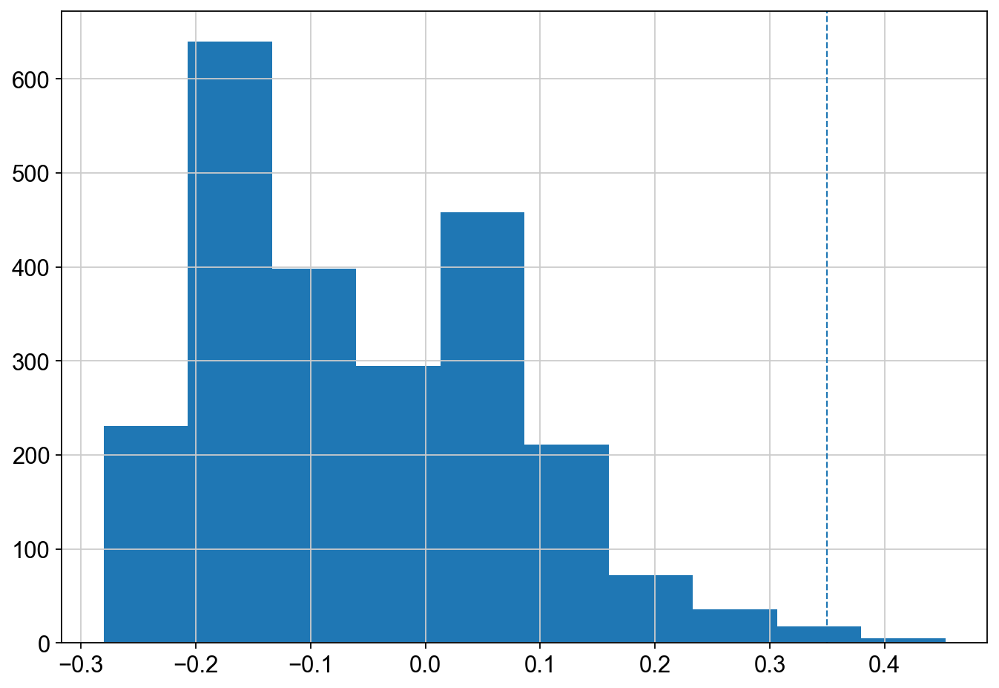

In [153]:
import matplotlib.pyplot as plt
fig, ax = plt.subplots(figsize =(10, 7))
ax.hist(nadata.obs.Cl5Bootstrap2)
ax.axvline(0.35, linestyle='dashed', linewidth=1)
# Show plot
plt.show()
#adata = adata[adata.X[:,adata.var.index.isin(['Ptprc'])] < 0.5,:]

In [154]:
nCl5Cells = nadata[nadata.obs.Cl5Bootstrap2 >= 0.35,:].obs.index
nnotCl5Cells = nadata[nadata.obs.Cl5Bootstrap2 < 0.35,:].obs.index

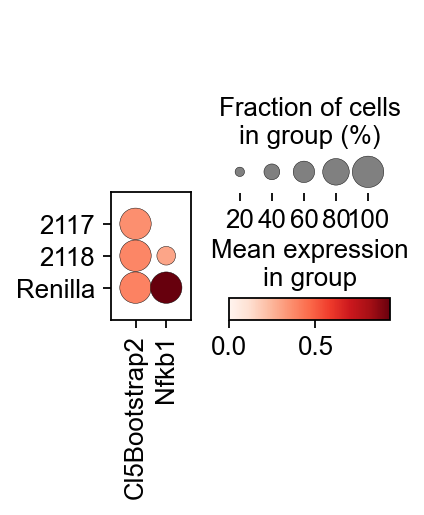

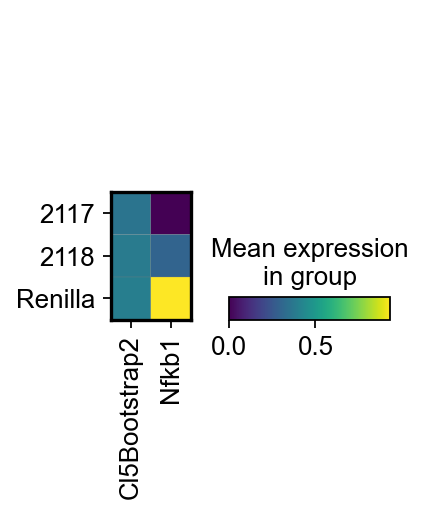

In [155]:
sc.pl.dotplot(nadata[nCl5Cells,:], ['Cl5Bootstrap2', 'Nfkb1'], groupby='Group')
sc.pl.matrixplot(nadata[nCl5Cells,:], ['Cl5Bootstrap2', 'Nfkb1'], groupby='Group')

/Users/chanj2/opt/miniconda3/envs/scanalysis202208/lib/python3.10/site-packages/scanpy/plotting/_tools/__init__.py:1488: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs[density_col_name] = dens_values


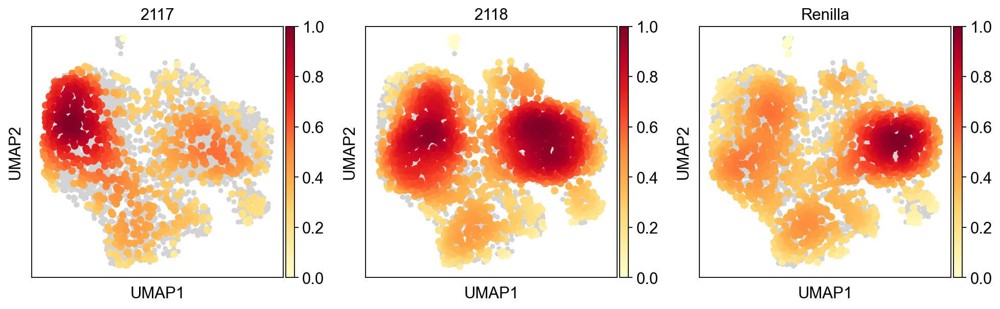

In [156]:
sc.pl.embedding_density(adata[notCl5Cells,:], basis='umap', key='umap_density_Group')

/Users/chanj2/opt/miniconda3/envs/scanalysis202208/lib/python3.10/site-packages/scanpy/plotting/_tools/__init__.py:1488: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs[density_col_name] = dens_values


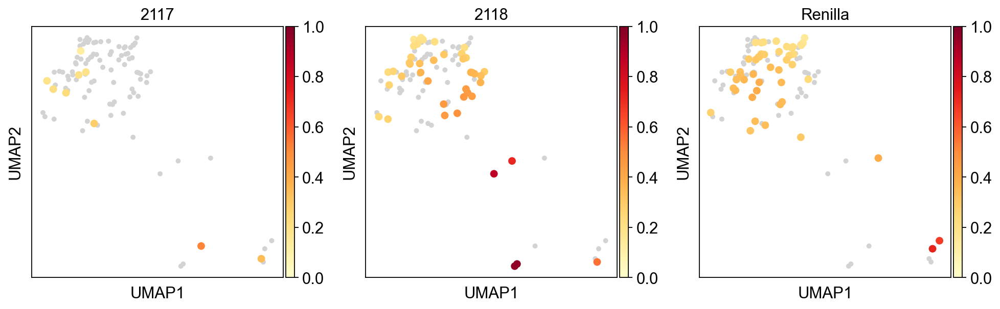

In [157]:
sc.pl.embedding_density(adata[Cl5Cells,:], basis='umap', key='umap_density_Group')

## Select GFP only and redo

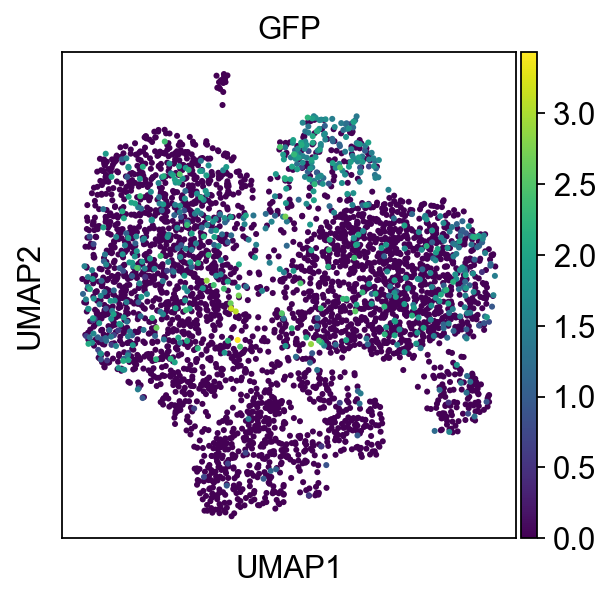

In [158]:
sc.pl.umap(adata, color='GFP')

In [159]:
#select only GFP cells
adata2 = adata[adata.obs.index.isin(GFPCells),:]


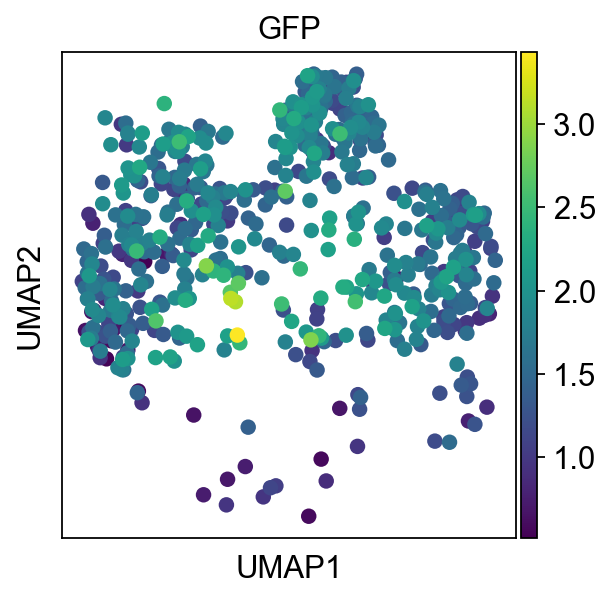

In [160]:
sc.pl.umap(adata2, color='GFP')

In [161]:
sc.tl.embedding_density(adata2, basis='umap', groupby='Group')

computing density on 'umap'
--> added
    'umap_density_Group', densities (adata.obs)
    'umap_density_Group_params', parameter (adata.uns)


/Users/chanj2/opt/miniconda3/envs/scanalysis202208/lib/python3.10/site-packages/scanpy/tools/_embedding_density.py:169: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs[density_covariate] = density_values


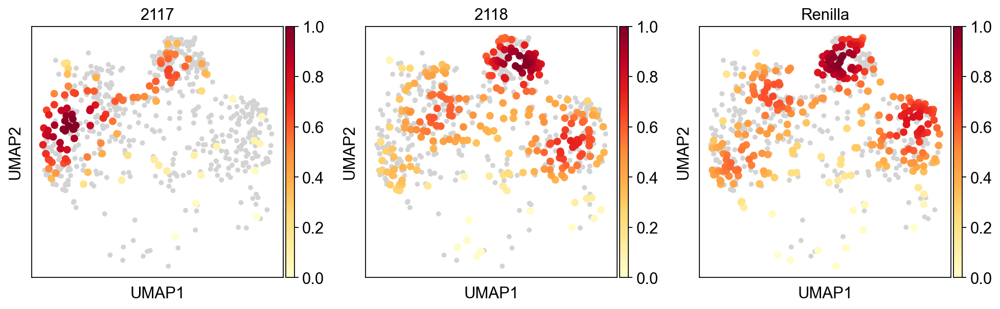

In [162]:
sc.pl.embedding_density(adata2, basis='umap', key='umap_density_Group')

computing score 'Cl5Bootstrap2'
    finished: added
    'Cl5Bootstrap2', score of gene set (adata.obs).
    765 total control genes are used. (0:00:00)


/Users/chanj2/opt/miniconda3/envs/scanalysis202208/lib/python3.10/site-packages/scanpy/tools/_score_genes.py:151: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  for cut in np.unique(obs_cut.loc[gene_list]):


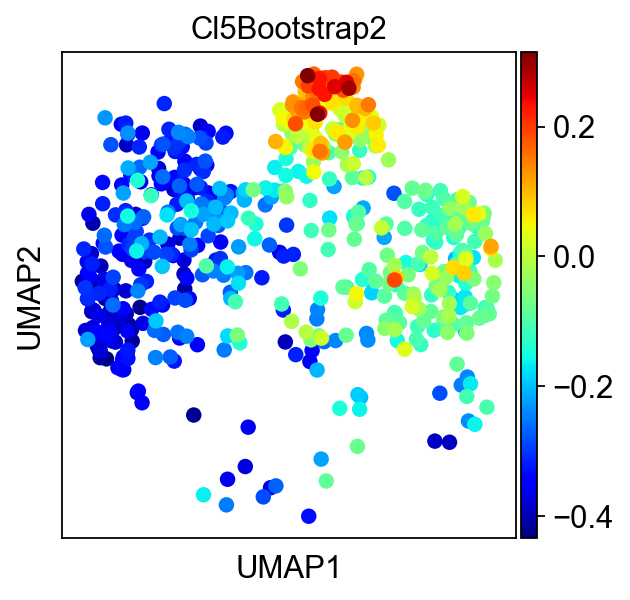

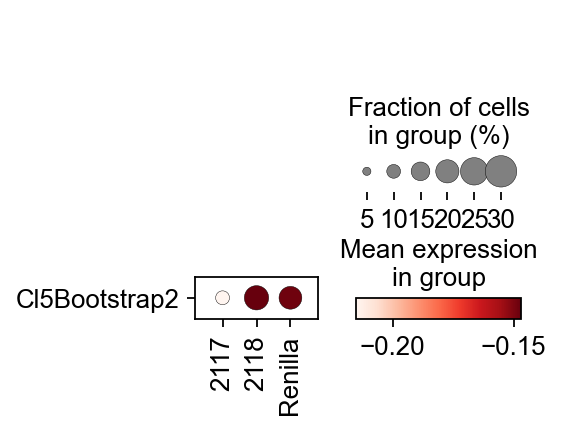

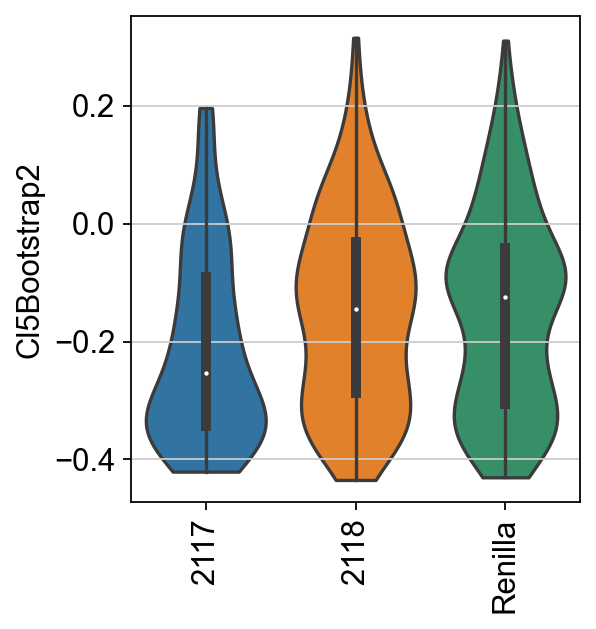

In [166]:
scoreAndPlot(adata2, groupby='Group',numGenes=250)

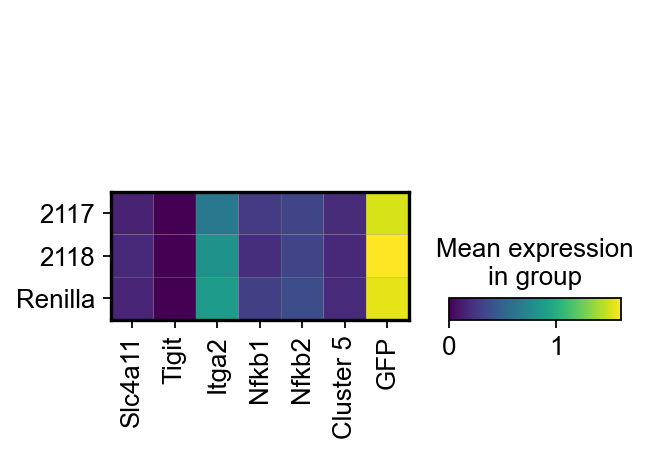

In [167]:
sc.pl.matrixplot(adata2,['Slc4a11','Tigit', 'Itga2','Nfkb1','Nfkb2','Cluster 5', 'GFP'],'Group')

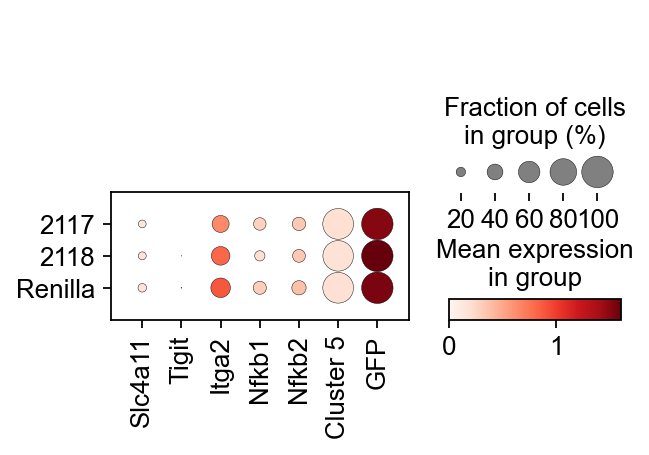

In [168]:
sc.pl.dotplot(adata2,['Slc4a11','Tigit', 'Itga2','Nfkb1','Nfkb2','Cluster 5', 'GFP'],'Group')

computing score 'Cl5Bootstrap2'
    finished: added
    'Cl5Bootstrap2', score of gene set (adata.obs).
    725 total control genes are used. (0:00:00)


/Users/chanj2/opt/miniconda3/envs/scanalysis202208/lib/python3.10/site-packages/scanpy/tools/_score_genes.py:151: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  for cut in np.unique(obs_cut.loc[gene_list]):


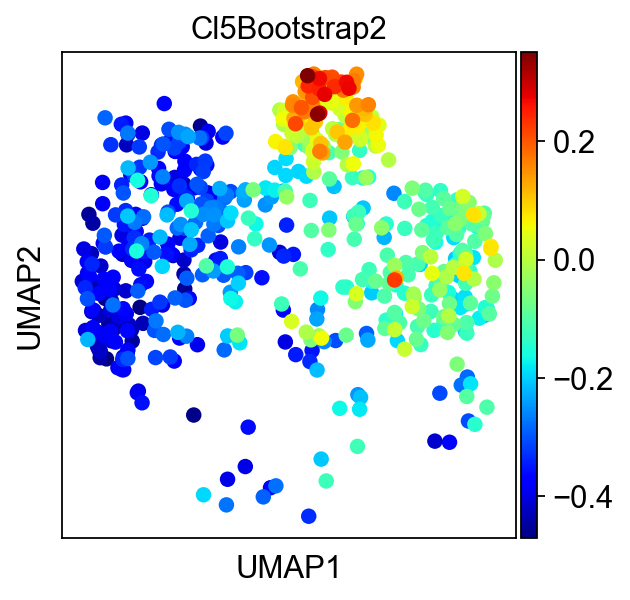

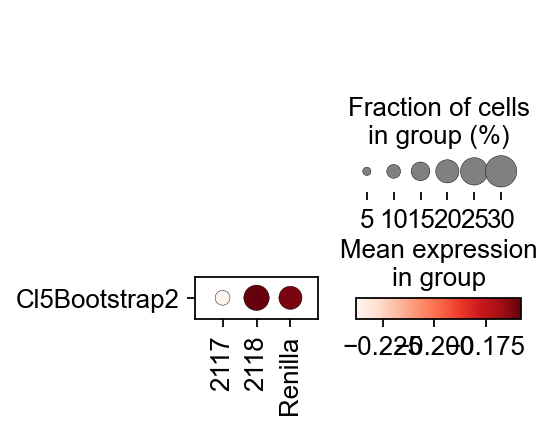

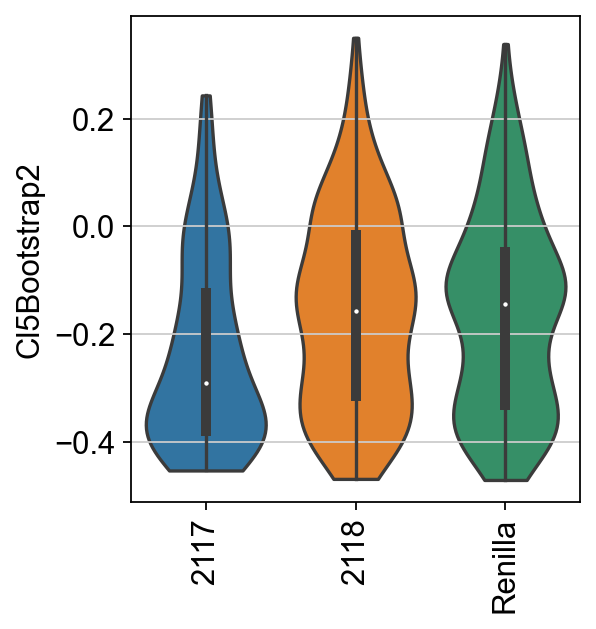

In [169]:
(clusters, clusterkeys, HPCS) = resetClusters('cl5bootstrap2')
scoreAndPlot(adata2, groupby='Group',numGenes=200)

In [170]:
adata2.obs.Group.value_counts()

Renilla    266
2118       244
2117       109
Name: Group, dtype: int64

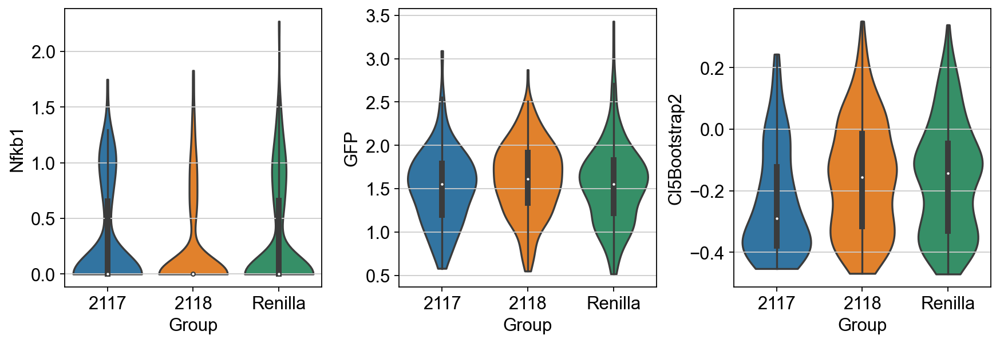

In [171]:
sc.pl.violin(adata2, ['Nfkb1', 'GFP', 'Cl5Bootstrap2'], groupby='Group',stripplot=False, inner='box')

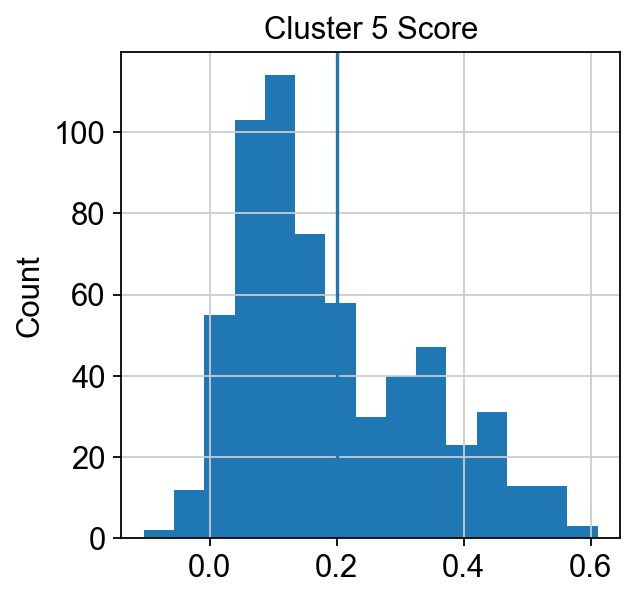

In [172]:
import matplotlib.pyplot as plt
_ = plt.hist(adata2.obs['Cluster 5'], bins='auto')
plt.ylabel("Count")
plt.title("Cluster 5 Score")
plt.axvline(x=0.2)
plt.show()

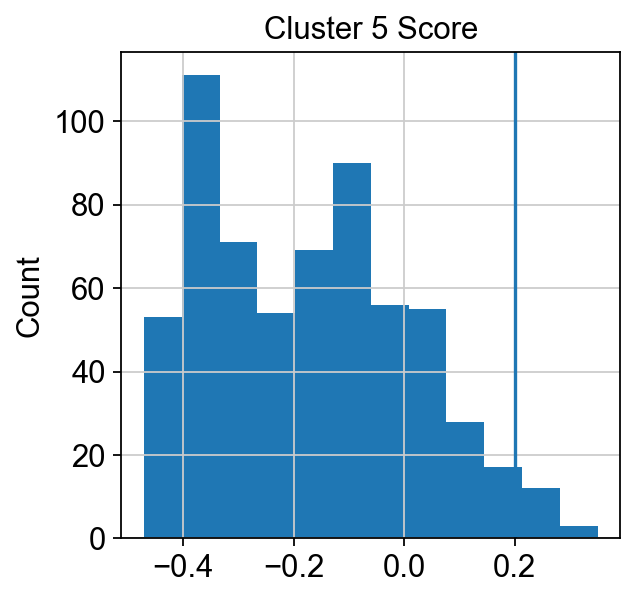

In [173]:
import matplotlib.pyplot as plt
_ = plt.hist(adata2.obs['Cl5Bootstrap2'], bins='auto')
plt.ylabel("Count")
plt.title("Cluster 5 Score")
plt.axvline(x=0.2)
plt.show()

    using 'X_pca' with n_pcs = 150
Storing dendrogram info using `.uns['dendrogram_Group']`


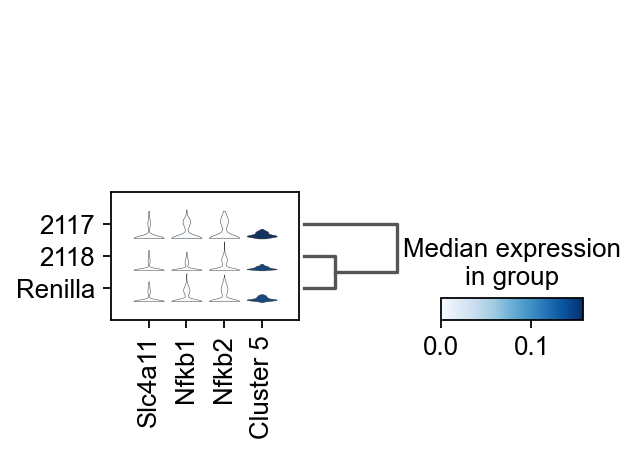

In [174]:
sc.pl.stacked_violin(adata2, ['Slc4a11','Nfkb1','Nfkb2','Cluster 5'], groupby='Group', swap_axes=False, dendrogram=True)

In [134]:
gCl5Cells = adata2[adata2.obs.Cl5Bootstrap2 >= 0.2,:].obs.index
gnotCl5Cells = adata2[adata2.obs.Cl5Bootstrap2 < 0.2,:].obs.index

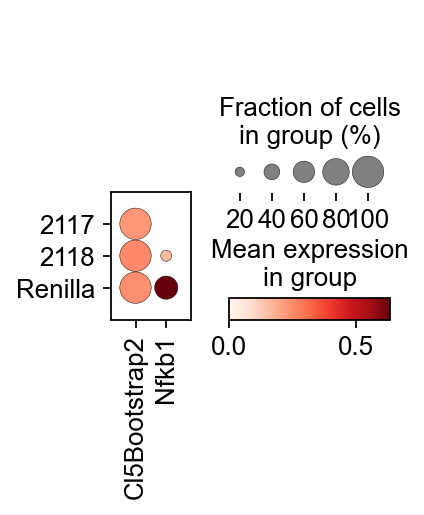

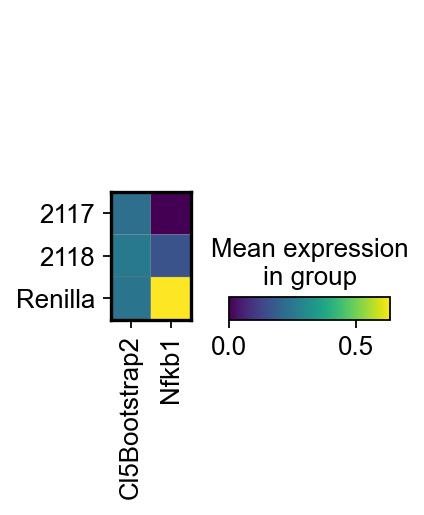

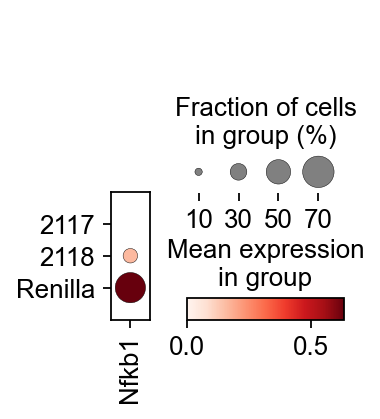

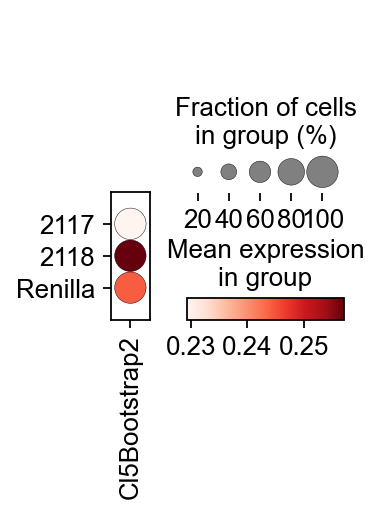

In [178]:
sc.pl.dotplot(adata2[gCl5Cells,:], ['Cl5Bootstrap2', 'Nfkb1'], groupby='Group')
sc.pl.matrixplot(adata2[gCl5Cells,:], ['Cl5Bootstrap2', 'Nfkb1'], groupby='Group')
sc.pl.dotplot(adata2[gCl5Cells,:], ['Nfkb1'], groupby='Group')
sc.pl.dotplot(adata2[gCl5Cells,:], ['Cl5Bootstrap2'], groupby='Group')

/Users/chanj2/opt/miniconda3/envs/scanalysis202208/lib/python3.10/site-packages/scanpy/plotting/_tools/__init__.py:1488: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs[density_col_name] = dens_values


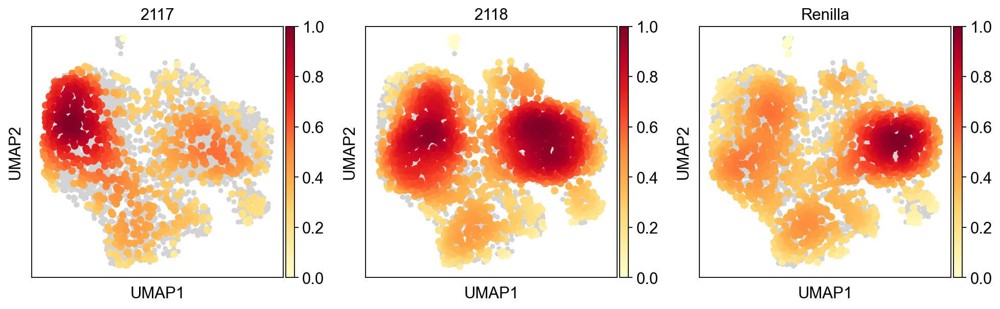

In [176]:
sc.pl.embedding_density(adata[notCl5Cells,:], basis='umap', key='umap_density_Group')

In [137]:
adata2.obs.Group.value_counts()

Renilla    266
2118       244
2117       109
Name: Group, dtype: int64

In [138]:
adata2[gCl5Cells,:].obs.Group.value_counts()

Renilla    9
2118       8
2117       2
Name: Group, dtype: int64